In [2]:
import torch
import torch.nn as nn
from torch.nn import BCELoss
import torch.nn.functional as F
import openslide

from os.path import join 

import joblib
import pandas as pd 
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.decomposition import PCA

from pytorch_metric_learning.distances import SNRDistance
from pytorch_metric_learning.utils.inference import CustomKNN

import seaborn as sns 

import logging

import matplotlib.pyplot as plt
import torch
import torch.nn as nn

# import umap
from cycler import cycler
from PIL import Image


import pytorch_metric_learning
import pytorch_metric_learning.utils.logging_presets as logging_presets
from pytorch_metric_learning import losses, miners, samplers, testers, trainers
from pytorch_metric_learning.utils.accuracy_calculator import AccuracyCalculator

from skimage import io
from skimage.metrics import structural_similarity as ssim
import os
from os import listdir 
from os.path import join 
from pandas import read_pickle, DataFrame, read_csv
import numpy as np 
import pandas as pd 
import openslide 
import matplotlib.pyplot as plt
from matplotlib.patches import Circle
from sklearn import svm
from sklearn.cluster import KMeans
import torch 
from sklearn.semi_supervised import LabelSpreading
# import umap.parametric_umap as pumap
import hdbscan
import random
import seaborn as sns 
from collections import defaultdict
import joblib 
from PIL import Image
import torchvision.transforms as transforms

import sys 
sys.path.insert(1, '/sc/arion/projects/tauomics/danielk/hover_net_models/dino')
import vision_transformer as vits 
import json 

In [3]:
image_path = 'path/to/image'
path_for_slide = lambda x: join(image_path, x + '.svs')
def get_tile(slide, coords): 
    if slide == '0_5ad0c3f8-0fdf-1d64-b8e2-feae32f3224c_122233': 
        slide = '5ad0c3f8-0fdf-1d64-b8e2-feae32f3224c_122233'
    x, y = np.array(coords).astype(int)
    wsi = openslide.open_slide(path_for_slide(slide))
    return wsi.read_region((x, y), 0, (256, 256))

# get feats 
feat_dir = 'path/to/feature_directory'
def get_feats(pairs): 
    slide_mapper = {}
    out_fts = np.empty((len(pairs), 384))
    for i, (sid, coord) in enumerate(pairs): 
        if sid not in slide_mapper.keys(): 
            with torch.no_grad(): 
                fts = torch.load(join(feat_dir, 'features', sid + '.pt')).detach().cpu().numpy()
                crds = torch.load(join(feat_dir, 'coords', sid + '.pt')).detach().cpu().numpy()
                coord_dict = {tuple(crd): idx for idx, crd in enumerate(crds)}
                slide_mapper[sid] = {'feats': fts, 'coords': coord_dict}
                
        fts = slide_mapper[sid]['feats']
        coord_dict = slide_mapper[sid]['coords']
        coord_tuple = tuple(map(int, coord))
        j = coord_dict[coord_tuple]
        out_fts[i] = fts[j]
    return out_fts 

def display_images(slide_coords, n_start=0, n_images=64, nrows=8, ncols=8):
    random_order = np.random.choice(len(slide_coords), min(n_images, len(slide_coords)), replace=False)
    end_index = min(n_start + n_images, len(slide_coords))
    selected_images = slide_coords[random_order][n_start:end_index]
    selected_images = [get_tile(*_) for _ in selected_images]
    
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols*2, nrows*2))
    axes = axes.flatten()
    
    for ax, img in zip(axes, selected_images):
        ax.imshow(img)  
        ax.axis('off')  

    for ax in axes[len(selected_images):]:
        ax.axis('off')

    plt.tight_layout()
    plt.show()

In [4]:
df = pd.read_pickle('/path/to/MLP_Training_Results.pkl', compression='gzip')

In [5]:
df

The history saving thread hit an unexpected error (OperationalError('unable to open database file')).History will not be written to the database.


,Slide_ID,Coords,Cluster,Region,Attention Score,Percentile,logits,softmax,probability,predicted_label
0,89117,"[10146.0, 16548.0]",1,None,1.330544,0.205745,"[-3.9055240154266357, 3.826979875564575, -0.02...","[0.0004290674696676433, 0.9788346290588379, 0....",0.978835,1
1,89117,"[10146.0, 16804.0]",1,None,1.300649,0.190207,"[-4.201602458953857, 3.7958545684814453, 0.285...","[0.00032644844031892717, 0.9706575274467468, 0...",0.970658,1
2,89117,"[10146.0, 17060.0]",-1,None,1.535547,0.312298,"[-4.50305700302124, 3.810293436050415, 0.55933...","[0.00023602043802384287, 0.9624804258346558, 0...",0.962480,1
3,89117,"[10146.0, 17316.0]",1,None,1.399638,0.241657,"[-3.746148109436035, 4.066668510437012, -0.415...","[0.00039983188617043197, 0.9884178042411804, 0...",0.988418,1
4,89117,"[10146.0, 17572.0]",1,None,1.295020,0.187281,"[-3.8097641468048096, 4.432402610778809, -0.71...","[0.0002617203863337636, 0.9939510822296143, 0....",0.993951,1
...,...,...,...,...,...,...,...,...,...,...
31990483,4_26_183819,"[99760.0, 85648.0]",1,None,1.229408,0.118959,"[0.912802517414093, -0.3577696681022644, -0.52...","[0.6583142876625061, 0.18476970493793488, 0.15...",0.658314,0
31990484,4_26_183819,"[99760.0, 85904.0]",1,None,1.202052,0.109928,"[2.3998208045959473, -2.2530741691589355, -0.0...","[0.9147152304649353, 0.008720858953893185, 0.0...",0.914715,0
31990485,4_26_183819,"[99760.0, 86160.0]",1,None,1.222487,0.116674,"[2.3952126502990723, -1.109843134880066, -1.19...","[0.9455989599227905, 0.02841060981154442, 0.02...",0.945599,0
31990486,4_26_183819,"[99760.0, 86416.0]",1,None,1.196479,0.108088,"[2.2849411964416504, -1.5385671854019165, -0.6...","[0.931272029876709, 0.020349232479929924, 0.04...",0.931272,0


In [6]:
sub_df = df.sample(frac=1e-2)

In [7]:
pairs = sub_df[sub_df['predicted_label']==0].sort_values(by='probability', ascending=False)[['Slide_ID', 'Coords']].to_numpy()

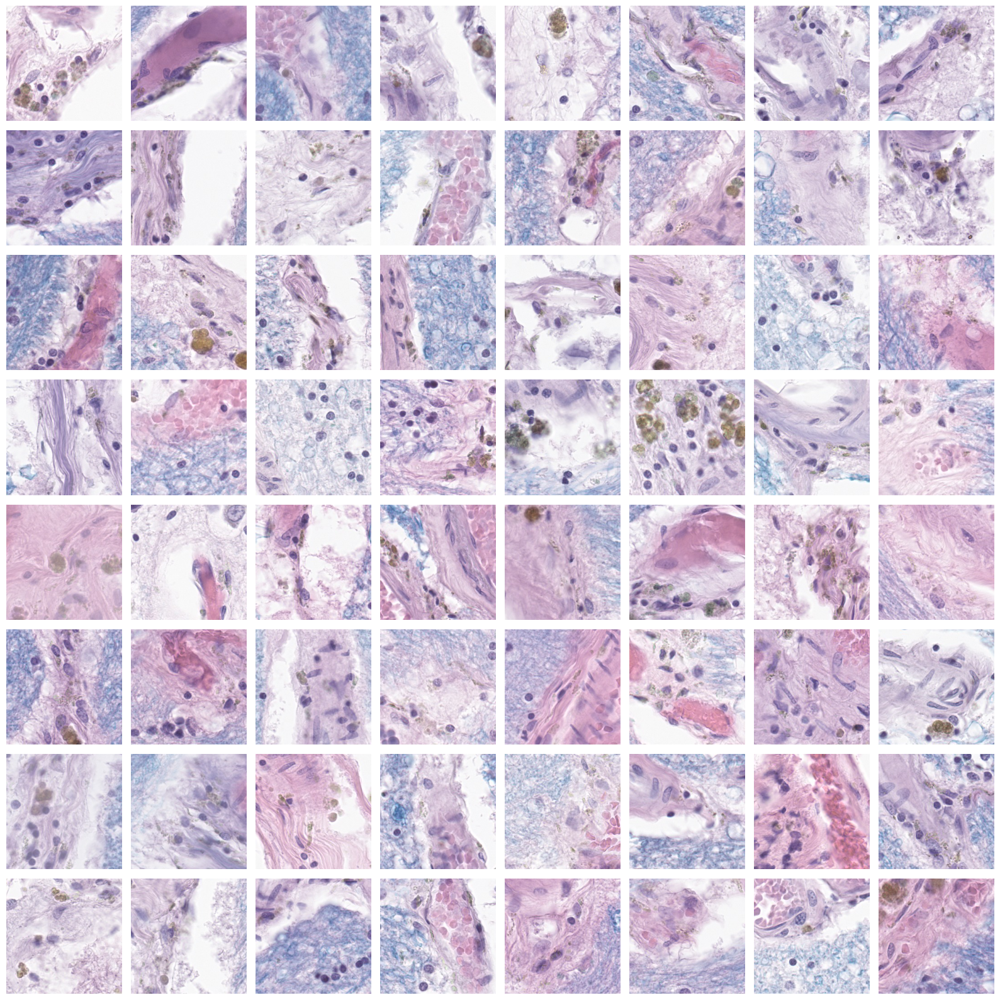

In [48]:
display_images(pairs[:64])

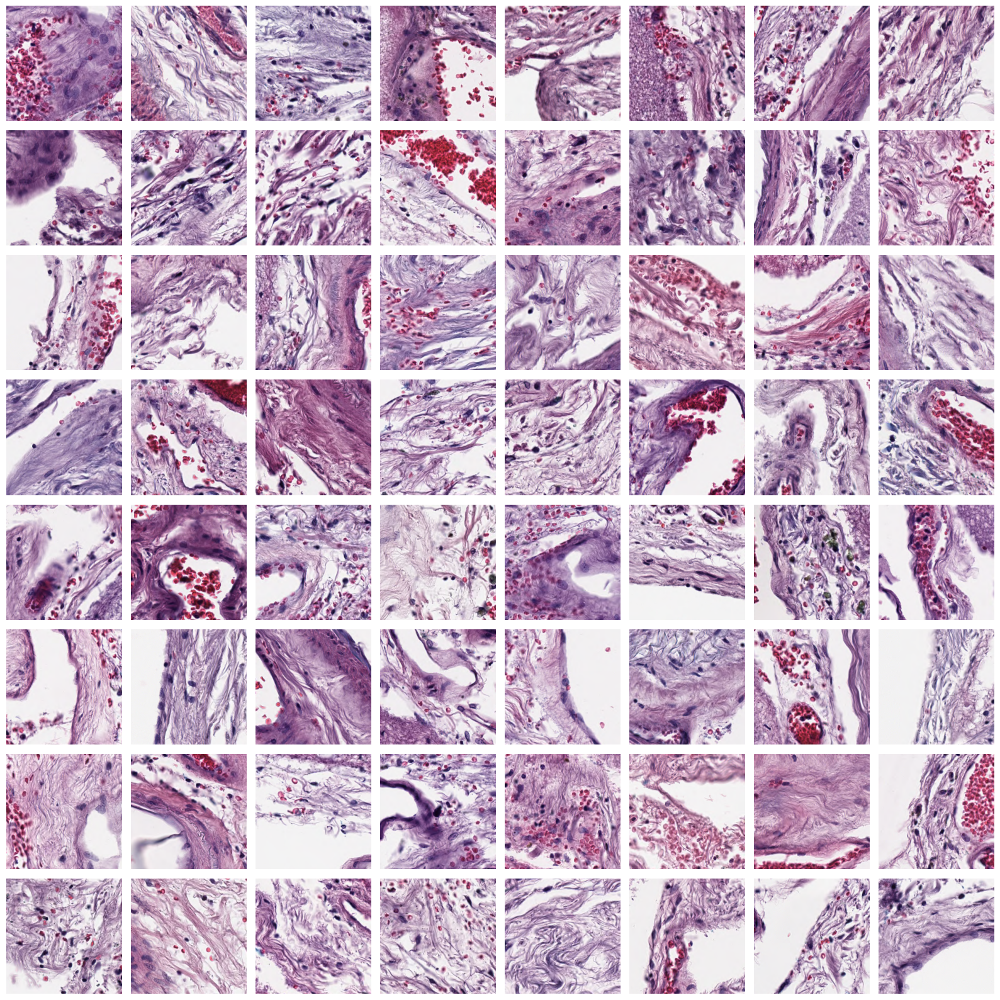

In [49]:
display_images(sub_df[sub_df['predicted_label']==1].sort_values(by='probability', ascending=False)[['Slide_ID', 'Coords']].to_numpy()[:64])

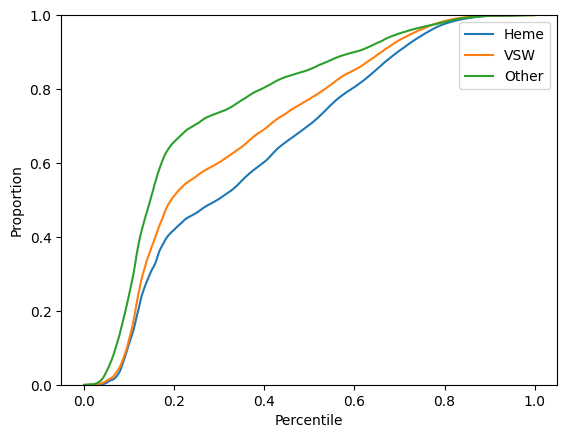

In [50]:
#90 
data = sub_df[sub_df['Percentile'] > 0]
sns.ecdfplot(data[data['predicted_label'] == 0], x='Percentile', label='Heme')
sns.ecdfplot(data[data['predicted_label'] == 1], x='Percentile', label='VSW')
sns.ecdfplot(data[data['predicted_label'] == 2], x='Percentile', label='Other')
plt.legend()
plt.show()

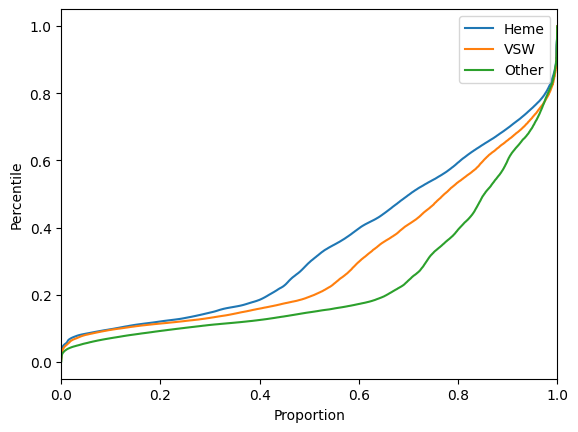

In [52]:
#90 
data = sub_df[sub_df['Percentile'] > 0]
sns.ecdfplot(data[data['predicted_label'] == 0], y='Percentile', label='Heme')
sns.ecdfplot(data[data['predicted_label'] == 1], y='Percentile', label='VSW')
sns.ecdfplot(data[data['predicted_label'] == 2], y='Percentile', label='Other')
plt.legend()
plt.show()

In [53]:
from sklearn.metrics import normalized_mutual_info_score

percentile_bins = pd.qcut(sub_df['Percentile'], q=10, labels=False, duplicates='drop') 
nmi_score = normalized_mutual_info_score(sub_df['predicted_label'], percentile_bins)

print(f'Normalized Mutual Information (NMI) Score: {nmi_score}')

Normalized Mutual Information (NMI) Score: 0.018030268699056797


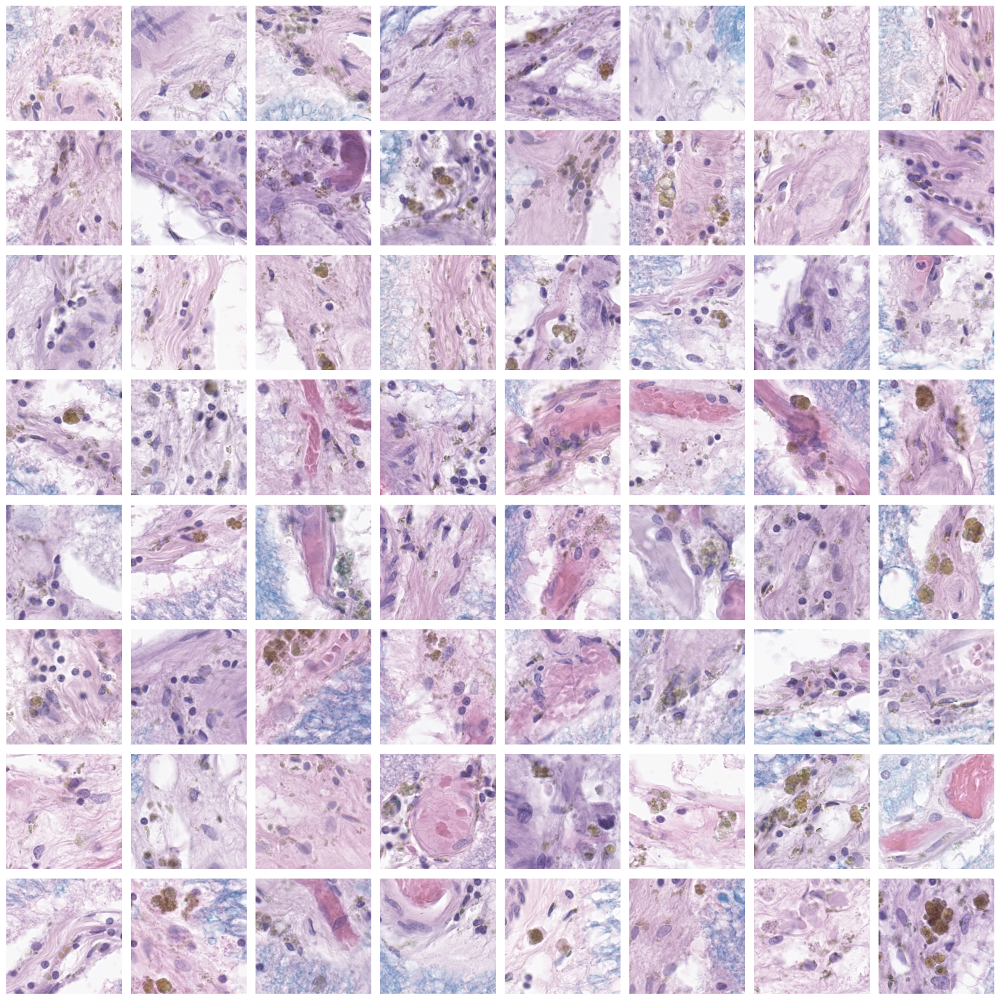

In [54]:
display_images(df[df['predicted_label']==0].sort_values(by='probability', ascending=False)[['Slide_ID', 'Coords']].to_numpy()[:64])

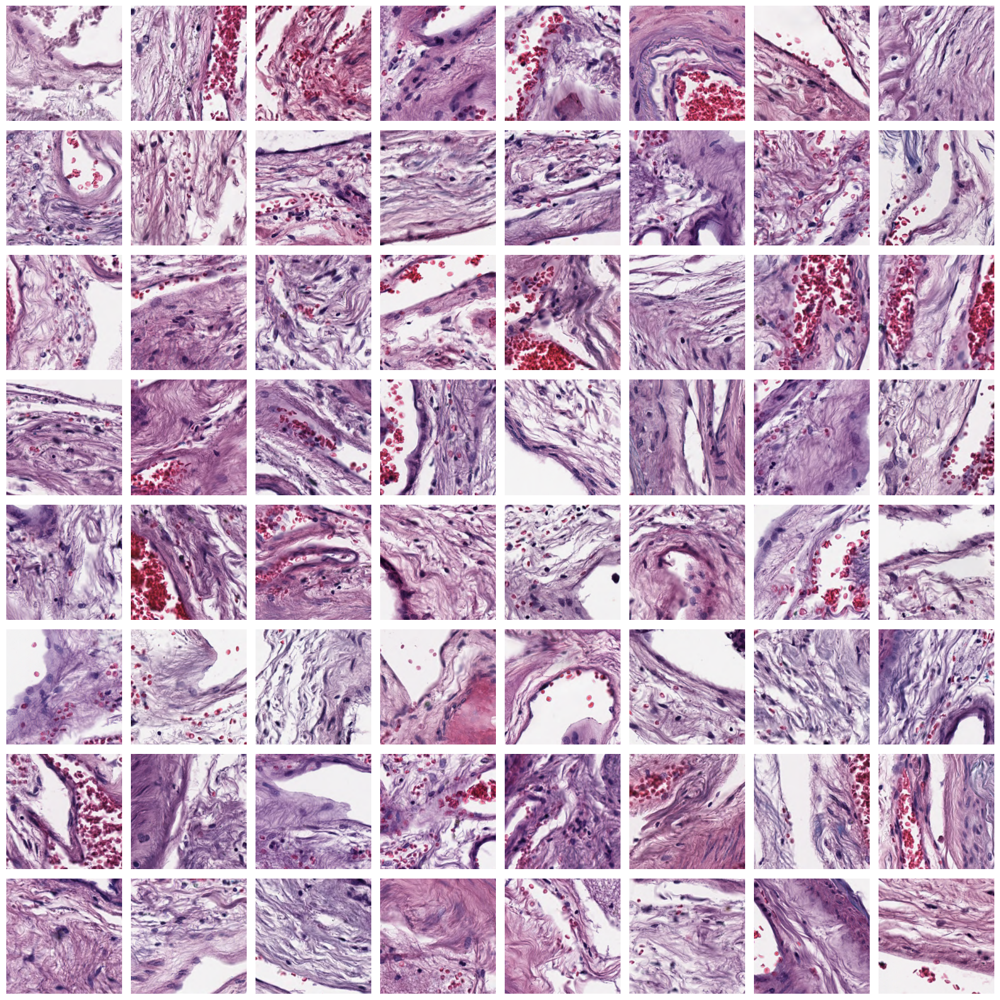

In [55]:
display_images(df[df['predicted_label']==1].sort_values(by='probability', ascending=False)[['Slide_ID', 'Coords']].to_numpy()[:64])

In [25]:
def labelizer(string): 
    if int(string) == 0: 
        return 'Hemosiderin'
    if int(string) == 1: 
        return 'Vessel Wall'
    if int(string) == 2: 
        return 'Other'
df['Predicted Label'] = np.vectorize(labelizer)(df['predicted_label'])

In [27]:
sub_df['Predicted Label'] = np.vectorize(labelizer)(sub_df['predicted_label'])

In [53]:
def getNewRegion(crest, white, inter, gray, sulc):
    if sulc: 
        return 'Sulcal Depth'
    if inter: 
        return 'Intermediate Zone'
    if crest: 
        return 'Crest'
    if white: 
        return 'White Matter'
    if gray: 
        return 'Gray Matter'
    else: 
        return 'Unknown'
    
def getRegionArray(rows): 
    new_regions = []
    for c, w, i, g, s in rows: 
        new_regions.append(getNewRegion(c, w, i, g, s))
    return new_regions 


regioned_df = pd.read_pickle('regioned_results_prcntl_df.pkl.gzip', compression='gzip')
regioned_df['Region'] = getRegionArray(regioned_df[['Crest', 'White Matter', 'Intermediate Zone', 'Gray Matter', 'Sulcal Depth']].to_numpy())

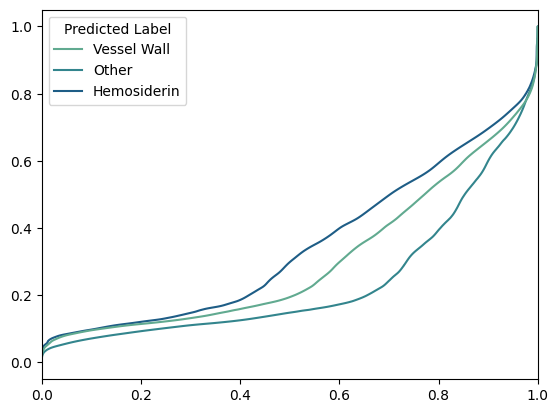

In [38]:
#90 
data = df.copy()
ax = sns.ecdfplot(data, y='Percentile', hue='Predicted Label', palette='crest', legend=True)
ax.set_xlabel('')
ax.set_ylabel('')
# plt.legend(title='Predicted Label', loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.show()

In [72]:
def find_intersection(percentiles): 
    sorted_percentiles = np.array(percentiles.copy())
    sorted_percentiles = np.sort(sorted_percentiles)
    index = np.where(sorted_percentiles > 0.5)[0][0]
    return index/len(percentiles)

intersections_heme = {label: find_intersection(df[df['Predicted Label']==label]['Percentile']) for label in ['Hemosiderin', 'Vessel Wall', 'Other']}
intersections_cluster = {label: find_intersection(df[df['Cluster']==label]['Percentile']) for label in [-1, 0, 1, 2]}
intersections_region = {label: find_intersection(regioned_df[regioned_df['Region']==label]['Percentile']) for label in ['Gray Matter', 'White Matter', 'Crest', 'Intermediate Zone', 'Sulcal Depth']}

[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         

[0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.000000

[0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.000000

[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         

[0.         0.01472019 0.01665123 0.01828147 0.01860439 0.01869595
 0.01882381 0.01884646 0.01900766 0.01910754 0.01934949 0.01957312
 0.01984104 0.01995206 0.01996227 0.01998267 0.02010111 0.02019271
 0.02041702 0.02047862 0.02060844 0.02075815 0.02115141 0.02120537
 0.02125564 0.02125801 0.02129129 0.02130884 0.02137258 0.02137578
 0.0214748  0.02150272 0.02158697 0.02170142 0.02173656 0.02181433
 0.02185968 0.02203047 0.02203858 0.02204424 0.02204512 0.02206297
 0.02215315 0.02215987 0.02221461 0.02224563 0.02229679 0.02232127
 0.02244019 0.0224491  0.02248383 0.0225997  0.02261553 0.02261666
 0.0227108  0.02274348 0.02274982 0.02280817 0.02289304 0.02293242
 0.02298126 0.02300959 0.02304237 0.02305684 0.02309927 0.02311022
 0.023126   0.02312647 0.02315537 0.02315972 0.02326475 0.02328607
 0.02336659 0.02338509 0.02340608 0.02342515 0.02346239 0.02347077
 0.02347861 0.02350981 0.02352725 0.02358824 0.02370982 0.02372421
 0.02378199 0.02381225 0.02382815 0.02383848 0.02386965 0.0239

[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.00046407 0.00080084 0.00302194
 0.00304913 0.00317768 0.00326969 0.00421742 0.00577561 0.00626804
 0.00640905 0.00649996 0.00674039 0.00691115 0.00716329 0.00720704
 0.00841917 0.00846937 0.00865706 0.00896015 0.00919838 0.0095959
 0.00963694 0.01000024 0.01008364 0.01008937 0.01021643 0.01037596
 0.01050486 0.01057412 0.01089834 0.01098077 0.01139527 0.01149989
 0.01152665 0.0116273  0.01201454 0.01202901 0.01207223 0.01244857
 0.01283902 0.01314971 0.01318687 0.01320174 0.01333135 0.01348732
 0.01362066 0.01376433 0.01376854 0.0137798  0.01394124 0.01408595
 0.01414488 0.01437135 0.01443954 0.01445426 0.01446354 0.01449581
 0.01451303 0.01461815 0.01474884 0.01476091 0.01477084 0.01481388
 0.01495694 0.01506119 0.01543997 0.01565042 0.01572624 0.01579096
 0.01589523 0.01610263 0.016194   0.0167032  0.01671063 0.01672309
 0.01682292 0.01683531 0.0168432  0.01690188 0.01693225 0.01702879
 0.0

[0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.000000

[0.         0.         0.         0.         0.         0.
 0.         0.         0.00165815 0.00334269 0.00578208 0.00596514
 0.00626609 0.00629319 0.0063008  0.00635551 0.00645657 0.00654716
 0.00680604 0.00682579 0.00686147 0.0071945  0.00737122 0.00803906
 0.00823959 0.0084943  0.00859686 0.00901702 0.00904851 0.00915333
 0.00930186 0.00948454 0.0095348  0.00958657 0.00972504 0.00976233
 0.00985476 0.0099356  0.01001832 0.01003594 0.01004382 0.01040005
 0.01045691 0.01045858 0.01048846 0.01058345 0.01073033 0.01078578
 0.01079106 0.01080401 0.01083221 0.01089322 0.01096165 0.01144738
 0.01157789 0.01166548 0.01173102 0.01183146 0.01216612 0.0123795
 0.01245646 0.01249578 0.01261956 0.01268755 0.01279863 0.0128966
 0.01293913 0.01302368 0.01320753 0.01324557 0.01331069 0.01350162
 0.01350791 0.01356954 0.01361767 0.01370827 0.01373569 0.01381021
 0.01391541 0.01397983 0.0139809  0.01405306 0.014059   0.01416852
 0.01432445 0.01464428 0.01469231 0.01469432 0.01477133 0.01484536
 0.01

In [90]:
def cmap(num_colors):
    colormap = plt.cm.get_cmap('viridis', num_colors)
    color_map = [colormap(i)[:3] for i in range(num_colors)]
    return color_map
color_map = cmap(4)
color_map = dict(zip([-1, 0, 1, 2], color_map))

order = ['Gray Matter', 'White Matter', 'Crest', 'Intermediate Zone', 'Sulcal Depth']
palette = sns.color_palette()
region_color_map = dict(zip(order, palette))
hem_color_map = {'Hemosiderin': 'brown', 'Vessel Wall': 'Red', 'Other': 'black'}

/tmp/ipykernel_32455/293904164.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = plt.cm.get_cmap('viridis', num_colors)


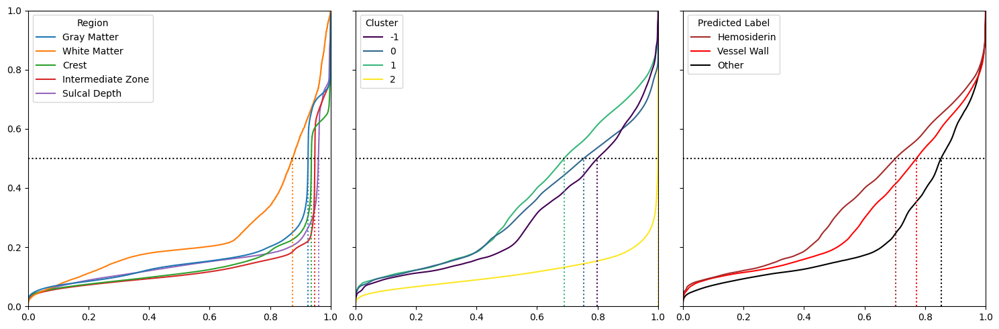

In [109]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5), sharey=True)

sns.ecdfplot(data=df, y='Percentile', hue='Predicted Label', hue_order=['Hemosiderin', 'Vessel Wall', 'Other'], palette=['brown', 'red', 'black'], legend=True, ax=axes[2])
sns.ecdfplot(data=df, y='Percentile', hue='Cluster', palette=color_map, legend=True, ax=axes[1])
sns.ecdfplot(data=regioned_df, y='Percentile', hue='Region', hue_order=order, legend=True, ax=axes[0])

intersection_mapper = {0: intersections_region, 1: intersections_cluster, 2: intersections_heme}
color_mapper = {0: region_color_map, 1: color_map, 2: hem_color_map}
for i in [0, 1, 2]: 
    for label, xvalue in intersection_mapper[i].items():
        color = color_mapper[i][label]
        axes[i].vlines(xvalue, 0, 0.5, color=color, linestyle='dotted')
    axes[i].hlines(0.5, 0, 1, color='black', linestyle='dotted')

sns.move_legend(axes[0], "upper left")
sns.move_legend(axes[1], "upper left")
sns.move_legend(axes[2], "upper left")

axes[0].set_xlabel('')
axes[0].set_ylabel('')
axes[1].set_xlabel('')
axes[1].set_ylabel('')
axes[2].set_xlabel('')
axes[2].set_ylabel('')

axes[0].set_ylim([0, 1])

plt.tight_layout()
plt.show()

In [89]:
def find_intersection(percentiles): 
    sorted_percentiles = np.array(percentiles.copy())
    sorted_percentiles = np.sort(sorted_percentiles)
    index = np.where(sorted_percentiles > 0.90)[0][0]
    return index/len(percentiles)

intersections_heme_90 = {label: find_intersection(df[df['Predicted Label']==label]['Percentile']) for label in ['Hemosiderin', 'Vessel Wall', 'Other']}
intersections_cluster_90 = {label: find_intersection(df[df['Cluster']==label]['Percentile']) for label in [-1, 0, 1, 2]}
intersections_region_90 = {label: find_intersection(regioned_df[regioned_df['Region']==label]['Percentile']) for label in ['Gray Matter', 'White Matter', 'Crest', 'Intermediate Zone', 'Sulcal Depth']}

/tmp/ipykernel_32455/1040991193.py:34: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[0].set_xticklabels(['0.0', '0.5', '1.0'], rotation=0, ha='right')
/tmp/ipykernel_32455/1040991193.py:35: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[1].set_xticklabels(['0.0', '0.5', '1.0'], rotation=0, ha='right')
/tmp/ipykernel_32455/1040991193.py:36: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[2].set_xticklabels(['0.0', '0.5', '1.0'], rotation=0, ha='right')


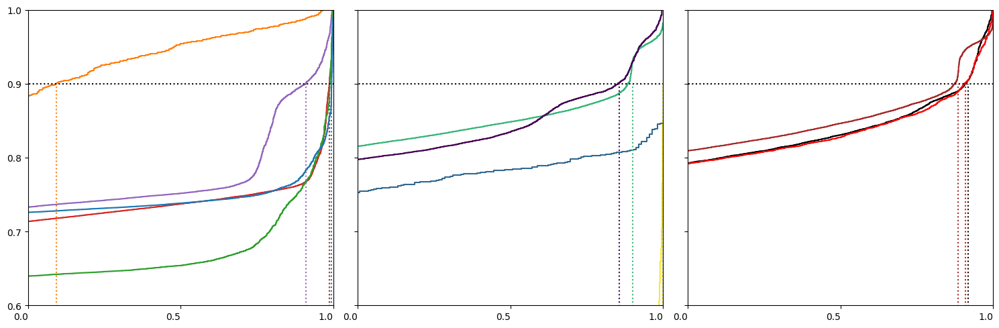

In [128]:
import matplotlib.ticker as ticker

fig, axes = plt.subplots(1, 3, figsize=(15, 5), sharey=True)

sns.ecdfplot(data=sub_df, y='Percentile', hue='Predicted Label', hue_order=['Hemosiderin', 'Vessel Wall', 'Other'], palette=['brown', 'red', 'black'], legend=False, ax=axes[2])
sns.ecdfplot(data=sub_df, y='Percentile', hue='Cluster', palette=color_map, legend=False, ax=axes[1])
sns.ecdfplot(data=regioned_df, y='Percentile', hue='Region', hue_order=order, legend=False, ax=axes[0])

intersection_mapper = {0: intersections_region_90, 1: intersections_cluster_90, 2: intersections_heme_90}
color_mapper = {0: region_color_map, 1: color_map, 2: hem_color_map}
for i in [0, 1, 2]: 
    for label, xvalue in intersection_mapper[i].items():
        color = color_mapper[i][label]
        axes[i].vlines(xvalue, 0, 0.9, color=color, linestyle='dotted')
    axes[i].hlines(0.9, 0, 1, color='black', linestyle='dotted')
    
axes[0].set_xlabel('')
axes[0].set_ylabel('')
axes[1].set_xlabel('')
axes[1].set_ylabel('')
axes[2].set_xlabel('')
axes[2].set_ylabel('')
axes[0].set_xlim([.98, 1])
axes[1].set_xlim([.98, 1])
axes[2].set_xlim([.98, 1])
axes[0].set_ylim([.6, 1])

axes[0].xaxis.set_major_locator(ticker.LinearLocator(3))  
axes[1].xaxis.set_major_locator(ticker.LinearLocator(3))  
axes[2].xaxis.set_major_locator(ticker.LinearLocator(3))

axes[0].yaxis.set_major_locator(ticker.LinearLocator(5))

axes[0].set_xticklabels(['0.0', '0.5', '1.0'], rotation=0, ha='right')
axes[1].set_xticklabels(['0.0', '0.5', '1.0'], rotation=0, ha='right')
axes[2].set_xticklabels(['0.0', '0.5', '1.0'], rotation=0, ha='right')

plt.tight_layout()
plt.show()

In [35]:
from sklearn.metrics import adjusted_mutual_info_score

df['Percentile_binarized'] = (df['Percentile'] < 0.3).astype(int)

labels = [0, 1, 2]
ami_scores = {}

for label in labels:
    df[f'Label_{label}_binarized'] = (df['predicted_label'] == label).astype(int)
    
    ami_score = adjusted_mutual_info_score(df['Percentile_binarized'], df[f'Label_{label}_binarized'])
    ami_scores[label] = ami_score

for label, score in ami_scores.items():
    print(f'Adjusted Mutual Information (AMI) between "Percentile > 0.5" and "Label {label}": {score}')

Adjusted Mutual Information (AMI) between "Percentile > 0.5" and "Label 0": 0.026451709895701444
Adjusted Mutual Information (AMI) between "Percentile > 0.5" and "Label 1": 0.00032142810103744345
Adjusted Mutual Information (AMI) between "Percentile > 0.5" and "Label 2": 0.030773538258165187


In [36]:
import pandas as pd
from scipy.stats import fisher_exact
from scipy.stats import chi2_contingency

threshold = .5 
label1 = 0 
label2 = 2 

filtered_data = df[df['predicted_label'].isin([label1, label2])]
filtered_data['Percentile_binarized'] = (filtered_data['Percentile'] >= threshold).astype(int)
contingency_table = pd.crosstab(filtered_data['Percentile_binarized'], filtered_data['predicted_label'])

if label1 not in contingency_table.columns:
    contingency_table[label1] = 0
if label2 not in contingency_table.columns:
    contingency_table[label2] = 0

contingency_table = contingency_table.loc[:, [label1, label2]]
odds_ratio, p_value = fisher_exact(contingency_table, alternative='two-sided')

print(f"Fisher's Exact Test p-value: {p_value}, Odds Ratio: {odds_ratio}")

chi2, p_value, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-square Test:\nChi-square Statistic: {chi2}, p-value: {p_value}")
print("Degrees of Freedom:", dof)
print("Expected Frequencies:\n", expected)

/tmp/ipykernel_32455/1719886696.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data['Percentile_binarized'] = (filtered_data['Percentile'] >= threshold).astype(int)


Fisher's Exact Test p-value: 0.0, Odds Ratio: 0.4070866652490933
Chi-square Test:
Chi-square Statistic: 716665.2453739995, p-value: 0.0
Degrees of Freedom: 1
Expected Frequencies:
 [[14196530.81171927  6477813.18828073]
 [ 4748591.18828073  2166760.81171927]]


In [37]:
contingency_table

predicted_label,0,2
Percentile_binarized,,
0,13302646,7371698
1,5642476,1272876


In [74]:
import pandas as pd
from scipy.stats import fisher_exact
from scipy.stats import chi2_contingency

threshold = .5 
label1 = 1 
label2 = 2 

filtered_data = df[df['predicted_label'].isin([label1, label2])]
filtered_data['Percentile_binarized'] = (filtered_data['Percentile'] >= threshold).astype(int)
contingency_table = pd.crosstab(filtered_data['Percentile_binarized'], filtered_data['predicted_label'])

if label1 not in contingency_table.columns:
    contingency_table[label1] = 0
if label2 not in contingency_table.columns:
    contingency_table[label2] = 0

contingency_table = contingency_table.loc[:, [label1, label2]]
odds_ratio, p_value = fisher_exact(contingency_table, alternative='two-sided')

print(f"Fisher's Exact Test p-value: {p_value}, Odds Ratio: {odds_ratio}")

chi2, p_value, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-square Test:\nChi-square Statistic: {chi2}, p-value: {p_value}")
print("Degrees of Freedom:", dof)
print("Expected Frequencies:\n", expected)
display(contingency_table)

/tmp/ipykernel_123705/3119124197.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data['Percentile_binarized'] = (filtered_data['Percentile'] >= threshold).astype(int)


Fisher's Exact Test p-value: 0.0, Odds Ratio: 0.5833943533505652
Chi-square Test:
Chi-square Statistic: 133196.53129361215, p-value: 0.0
Degrees of Freedom: 1
Expected Frequencies:
 [[3632342.50443629 7135091.49556371]
 [ 768449.49556371 1509482.50443629]]


predicted_label,1,2
Percentile_binarized,,
0,3395736,7371698
1,1005056,1272876


In [129]:
import pandas as pd
from scipy.stats import fisher_exact
from scipy.stats import chi2_contingency

threshold = .5 
label1 = 0 
label2 = 1 

filtered_data = df[df['predicted_label'].isin([label1, label2])]
filtered_data['Percentile_binarized'] = (filtered_data['Percentile'] >= threshold).astype(int)
contingency_table = pd.crosstab(filtered_data['Percentile_binarized'], filtered_data['predicted_label'])

if label1 not in contingency_table.columns:
    contingency_table[label1] = 0
if label2 not in contingency_table.columns:
    contingency_table[label2] = 0

contingency_table = contingency_table.loc[:, [label1, label2]]
odds_ratio, p_value = fisher_exact(contingency_table, alternative='two-sided')

print(f"Fisher's Exact Test p-value: {p_value}, Odds Ratio: {odds_ratio}")

chi2, p_value, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-square Test:\nChi-square Statistic: {chi2}, p-value: {p_value}")
print("Degrees of Freedom:", dof)
print("Expected Frequencies:\n", expected)
display(contingency_table)

/tmp/ipykernel_32455/3493106417.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data['Percentile_binarized'] = (filtered_data['Percentile'] >= threshold).astype(int)


Fisher's Exact Test p-value: 0.0, Odds Ratio: 0.6977898618851947
Chi-square Test:
Chi-square Statistic: 84580.72245656243, p-value: 0.0
Degrees of Freedom: 1
Expected Frequencies:
 [[13550674.61452158  3147707.38547842]
 [ 5394447.38547842  1253084.61452158]]


predicted_label,0,1
Percentile_binarized,,
0,13302646,3395736
1,5642476,1005056


In [168]:
import statsmodels.api as sm
from statsmodels.formula.api import ols

model = ols('Percentile ~ C(predicted_label)', data=df).fit()

anova_results = sm.stats.anova_lm(model, typ=2)  # Type 2 ANOVA DataFrame

print(anova_results)

                          sum_sq          df              F  PR(>F)
C(predicted_label)  7.193130e+04         2.0  718552.655395     0.0
Residual            1.601217e+06  31990485.0            NaN     NaN


In [79]:
import pandas as pd
import statsmodels.api as sm
from statsmodels.formula.api import ols

medians_by_slide = df.groupby(['Slide_ID', 'predicted_label'])['Percentile'].median().reset_index()
medians_by_slide.rename(columns={'Percentile': 'Median_Percentile'}, inplace=True)

model = ols('Median_Percentile ~ C(predicted_label) + C(Slide_ID)', data=medians_by_slide).fit()
anova_results = sm.stats.anova_lm(model, typ=2)  

print(anova_results)

                       sum_sq      df           F        PR(>F)
C(predicted_label)   2.513074     2.0  157.342685  5.662947e-63
C(Slide_ID)         97.436446   792.0   15.405205  0.000000e+00
Residual            12.458145  1560.0         NaN           NaN


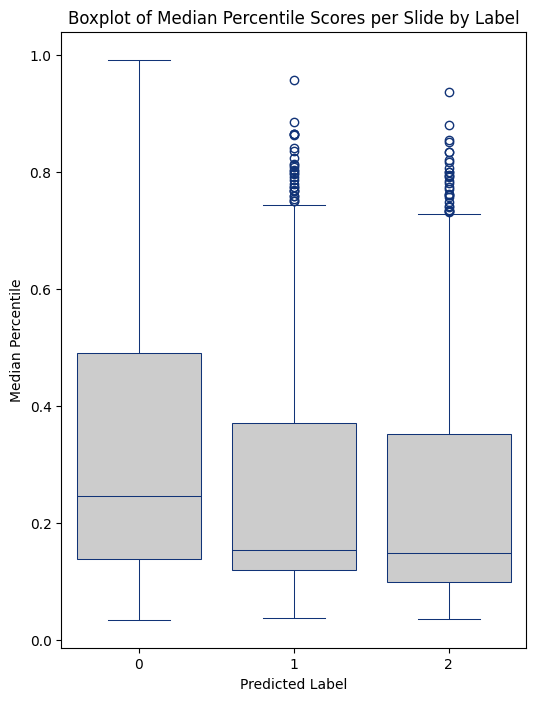

In [83]:
plt.figure(figsize=(6, 8)) 
sns.boxplot(x='predicted_label', y='Median_Percentile', data=medians_by_slide, color=".8", linecolor="#137", linewidth=.75)
plt.title('Boxplot of Median Percentile Scores per Slide by Label')
plt.xlabel('Predicted Label')
plt.ylabel('Median Percentile')
plt.show()

In [141]:
label_counts = df.groupby(['Slide_ID', 'predicted_label']).size().reset_index(name='count')

pivot_table = label_counts.pivot_table(index='Slide_ID', columns='predicted_label', values='count', fill_value=0)

pivot_table.columns = [f'Label_{int(label)}_Count' for label in pivot_table.columns]
pivot_table.reset_index(inplace=True)

pivot_table

,Slide_ID,Label_0_Count,Label_1_Count,Label_2_Count
0,100501,20.0,2017.0,7949.0
1,101059,3.0,4645.0,10489.0
2,101223,7.0,1914.0,1439.0
3,101849,0.0,2295.0,18408.0
4,10220,75.0,4318.0,6801.0
...,...,...,...,...
788,"K64, K65, K38, K39, K44-007",35.0,2662.0,11120.0
789,LHE-006,1.0,3773.0,15126.0
790,Rescanned block 7 + Russ-021,3.0,2131.0,12305.0
791,bb8b9df8-8cbf-01f8-d050-895b35b14af7_192201,44998.0,13963.0,8374.0


In [142]:
pivot_table.to_pickle('labeled_counted_by_slide.pkl.gzip', compression='gzip')

In [143]:
rhi = read_csv('parkman_rhi_clinical_full.tsv', sep='\t')
rhi['Slide_ID'] = rhi['Slide_ID'].str.replace('.svs', '', regex=False)

In [144]:
merged_df = pd.merge(rhi, pivot_table, on='Slide_ID', how='inner') 
merged_df

,subjid,Slide_ID,Scanner and magnification,aestot,OtherContactSport,fafe,highlev,footyrs,poshigh,hockyrs,...,cod,DementiaHx,GDStot,agedeath,CTE,CTEStage,nodata,Label_0_Count,Label_1_Count,Label_2_Count
0,K0007,12043,20X_AT2,NaN,Yes,13.0,Professional,13.0,Multiple,6.0,...,Neurodegenerative,Yes,NaN,71.0,Yes,Stage IV,NaN,13.0,3277.0,7779.0
1,K0009,12058,20X_AT2,NaN,Yes,NaN,NaN,NaN,NaN,NaN,...,Neurodegenerative,Yes,NaN,73.0,Yes,Stage IV,NaN,8.0,4930.0,12438.0
2,K0010,7_17_212241,20X_AT2,NaN,No,NaN,NaN,NaN,NaN,NaN,...,Cancer,No,NaN,76.0,No,NaN,NaN,68940.0,7930.0,5313.0
3,K0016,4_22_161853,40X_GT450,NaN,No,NaN,NaN,NaN,NaN,NaN,...,Neurodegenerative,Yes,NaN,98.0,No,NaN,NaN,55282.0,5323.0,8559.0
4,K0017,110837,20X_AT2,NaN,Yes,18.0,College,1.0,Tight End,NaN,...,Neurodegenerative,Yes,NaN,74.0,No,NaN,NaN,11.0,1562.0,7809.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
696,SLI201,12601,20X_AT2,NaN,No,15.0,Professional,14.0,Defensive Line,NaN,...,Neurodegenerative,Yes,NaN,82.0,Yes,Stage III,NaN,59.0,2568.0,8497.0
697,SLI203,12611,20X_AT2,NaN,No,10.0,Professional,33.0,Quarterback,NaN,...,Neurodegenerative,Yes,NaN,79.0,Yes,Stage IV,NaN,5.0,1937.0,11939.0
698,SLI206,12630,20X_AT2,NaN,No,10.0,Professional,15.0,Linebacker,NaN,...,Cancer,Yes,NaN,71.0,Yes,Stage IV,NaN,40.0,1889.0,9502.0
699,SLI212,109653,20X_AT2,NaN,No,9.0,Professional,13.5,Linebacker,NaN,...,Motor Neuron Disease,No,NaN,52.0,Yes,Stage II,NaN,4.0,3099.0,15923.0


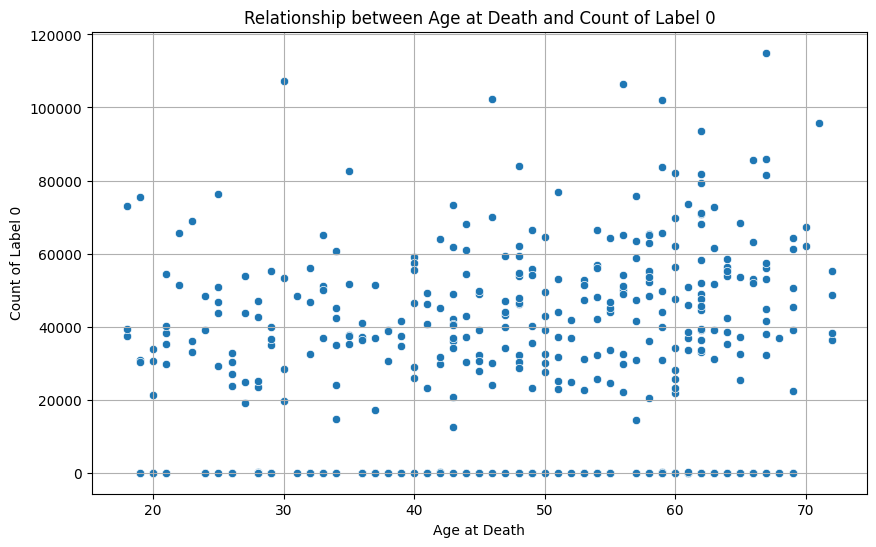

In [134]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x='aestot', y='Label_0_Count', data=merged_df)

plt.title('Relationship between Age at Death and Count of Label 0')
plt.xlabel('Age at Death')
plt.ylabel('Count of Label 0')
plt.grid(True) 
plt.show()

In [135]:
merged_df[merged_df['Label_0_Count']==1]

,subjid,Slide_ID,Scanner and magnification,aestot,OtherContactSport,fafe,highlev,footyrs,poshigh,hockyrs,...,cod,DementiaHx,GDStot,agedeath,CTE,CTEStage,nodata,Label_0_Count,Label_1_Count,Label_2_Count
18,K0044,LHE-006,20X_AT2,NaN,No,NaN,NaN,NaN,NaN,NaN,...,Other,No,NaN,72.0,No,NaN,NaN,1.0,3773.0,15126.0
33,K0068,171491,20X_AT2,NaN,Yes,NaN,NaN,NaN,NaN,NaN,...,Suicide,No,NaN,21.0,No,NaN,NaN,1.0,2363.0,18526.0
37,K0073,"K-34, K-37, K-54, K-55, K-66, K-73-014",20X_AT2,NaN,No,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,87.0,No,NaN,NaN,1.0,1929.0,9750.0
39,K0075,10799,20X_AT2,NaN,No,12.0,Professional,19.0,Defensive Back,NaN,...,Neurodegenerative,Yes,NaN,77.0,Yes,Stage IV,NaN,1.0,3216.0,7488.0
74,K0116,171495,20X_AT2,38.0,Yes,5.0,High school,9.5,Multiple,NaN,...,Injury,No,7.0,22.0,No,NaN,NaN,1.0,1840.0,18315.0
102,K0151,40856,20X_AT2,37.0,No,10.0,College,10.0,Defensive Line,NaN,...,Other,No,12.0,47.0,Yes,Stage III,NaN,1.0,2838.0,9541.0
106,K0155,41631,20X_AT2,37.0,No,NaN,NaN,NaN,NaN,NaN,...,Neurodegenerative,Yes,3.0,85.0,No,NaN,NaN,1.0,9263.0,13074.0
107,K0156,8497,20X_AT2,32.0,Yes,16.0,Professional,17.0,Other (Special teams),NaN,...,Injury,No,0.0,36.0,Yes,Stage I,NaN,1.0,2425.0,20773.0
180,K0250,67833,20X_AT2,20.0,Yes,3.0,High school,16.0,Multiple,NaN,...,Suicide,No,0.0,26.0,Yes,Stage I,NaN,1.0,3130.0,22114.0
194,K0275,64156,20X_AT2,NaN,No,8.0,Professional,13.0,Linebacker,NaN,...,Cardiovascular Disease,Yes,15.0,49.0,Yes,Stage III,NaN,1.0,2417.0,14365.0


                            OLS Regression Results                            
Dep. Variable:          Label_0_Count   R-squared:                       0.017
Model:                            OLS   Adj. R-squared:                  0.015
Method:                 Least Squares   F-statistic:                     7.477
Date:                Tue, 23 Apr 2024   Prob (F-statistic):            0.00651
Time:                        19:27:56   Log-Likelihood:                -5058.8
No. Observations:                 437   AIC:                         1.012e+04
Df Residuals:                     435   BIC:                         1.013e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       2.622e+04   2525.810     10.381      0.0

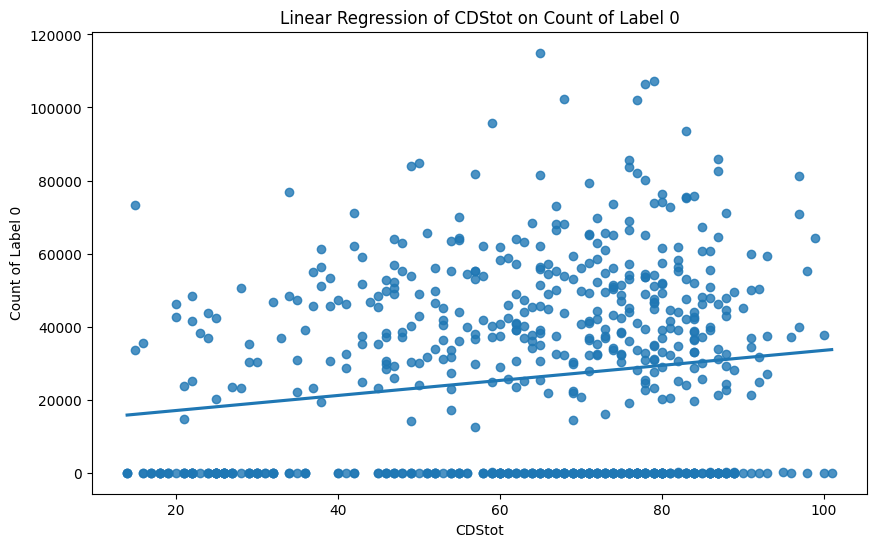

In [113]:
import statsmodels.api as sm
label = 'CDStot'

# Assuming 'merged_df' contains 'agedeath' and 'Label_0_Count'
cleaned_df = merged_df.dropna(subset=[label, 'Label_0_Count'])

# Simple Linear Regression
X = sm.add_constant(cleaned_df[label])  # adding a constant
model = sm.OLS(cleaned_df['Label_0_Count'], X).fit()

print(model.summary())

# Plotting the regression line over the scatter plot
plt.figure(figsize=(10, 6))
sns.regplot(x='agedeath', y='Label_0_Count', data=merged_df, ci=None)  # ci=None removes the confidence interval
plt.title(f'Linear Regression of {label} on Count of Label 0')
plt.xlabel(f'{label}')
plt.ylabel('Count of Label 0')
plt.show()

In [150]:
df['label_0_score'] = df['Label_0_binarized']*df['Percentile']
df['label_1_score'] = df['Label_1_binarized']*df['Percentile']

In [151]:
stats_df = df.groupby('Slide_ID').agg({
    'label_0_score': ['mean', 'median', 'sum', 'std'],
    'label_1_score': ['mean', 'median', 'sum', 'std']
}).reset_index()

# Rename columns for clarity
stats_df.columns = ['Slide_ID', 
                    'label_0_score_mean', 'label_0_score_median', 'label_0_score_sum', 'label_0_score_std',
                    'label_1_score_mean', 'label_1_score_median', 'label_1_score_sum', 'label_1_score_std']

In [152]:
label_0_counts = df[(df['Label_0_binarized'] == 1) & (df['Percentile'] > 0.5)].groupby('Slide_ID').size().reset_index(name='label_0_high_percentile_count')
label_1_counts = df[(df['Label_1_binarized'] == 1) & (df['Percentile'] > 0.5)].groupby('Slide_ID').size().reset_index(name='label_1_high_percentile_count')
counts_df = pd.merge(label_0_counts, label_1_counts, on='Slide_ID', how='outer').fillna(0)

In [153]:
merged_df = pd.merge(rhi, pivot_table, on='Slide_ID', how='inner') 
merged_df = pd.merge(counts_df, merged_df, on='Slide_ID', how='inner')
merged_df = pd.merge(merged_df, stats_df, on='Slide_ID', how='inner') 
merged_df['cod=suicide'] = merged_df['cod'] == 'Suicide'
merged_df

,Slide_ID,label_0_high_percentile_count,label_1_high_percentile_count,subjid,Scanner and magnification,aestot,OtherContactSport,fafe,highlev,footyrs,...,Label_2_Count,label_0_score_mean,label_0_score_median,label_0_score_sum,label_0_score_std,label_1_score_mean,label_1_score_median,label_1_score_sum,label_1_score_std,cod=suicide
0,102724,5.0,16.0,K0286,20X_AT2,33.0,No,7.0,College,17.0,...,17505.0,0.000263,0.000000,5.323370,0.011068,0.016779,0.0,339.718911,0.049859,True
1,10806,1.0,47.0,K0078,20X_AT2,NaN,No,NaN,NaN,NaN,...,7697.0,0.000262,0.000000,2.719903,0.009388,0.035536,0.0,368.296877,0.077185,False
2,10816,18.0,117.0,K0081,20X_AT2,NaN,Yes,15.0,College,6.0,...,9359.0,0.001420,0.000000,16.777604,0.032424,0.036762,0.0,434.416525,0.098469,False
3,10822,3.0,42.0,K0082,20X_AT2,NaN,No,12.0,Professional,20.0,...,8943.0,0.000238,0.000000,2.782266,0.012255,0.028192,0.0,329.118801,0.066464,False
4,10827,8.0,110.0,K0083,20X_AT2,NaN,No,15.0,Professional,12.0,...,16483.0,0.000430,0.000000,8.029858,0.014759,0.020402,0.0,380.889430,0.073791,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
643,9_18_192125,0.0,1.0,K0436,40X_GT450,30.0,No,NaN,NaN,NaN,...,7564.0,0.085157,0.120376,3525.417343,0.057718,0.016246,0.0,672.582736,0.042580,True
644,Ian oct18-068,0.0,27.0,K0027,20X_AT2,NaN,Yes,7.0,College,17.0,...,27951.0,0.000000,0.000000,0.000000,0.000000,0.014774,0.0,460.047394,0.050540,True
645,"K1302,7,LHE_175613",0.0,1.0,K1302,40X_GT450,29.0,Yes,14.0,High school,4.0,...,3228.0,0.338651,0.412386,15033.071614,0.157675,0.043729,0.0,1941.180269,0.128074,False
646,"K1319,7,LHE_155933",0.0,3.0,K1319,40X_GT450,38.0,No,8.0,College,12.0,...,1062.0,0.337856,0.374711,14526.113855,0.111378,0.027351,0.0,1175.977182,0.098391,False


In [138]:
merged_df.columns

Index(['Slide_ID', 'label_0_high_percentile_count',
       'label_1_high_percentile_count', 'subjid', 'Scanner and magnification',
       'aestot', 'OtherContactSport', 'fafe', 'highlev', 'footyrs', 'poshigh',
       'hockyrs', 'socyrs', 'wresyrs', 'boxyrs', 'bryrs', 'divyrs', 'karyrs',
       'lacyrs', 'maryrs', 'mmayrs', 'pwresyrs', 'rugyrs', 'eqyrs', 'ssyrs',
       'fhyrs', 'bistot', 'tbri', 'tmi', 'tgec', 'maxaggsum', 'CDStot',
       'gender', 'race', 'edlevel', 'cod', 'DementiaHx', 'GDStot', 'agedeath',
       'CTE', 'CTEStage', 'nodata', 'Label_0_Count', 'Label_1_Count',
       'Label_2_Count', 'label_0_score_mean', 'label_0_score_median',
       'label_0_score_sum', 'label_0_score_std', 'label_1_score_mean',
       'label_1_score_median', 'label_1_score_sum', 'label_1_score_std'],
      dtype='object')

                            OLS Regression Results                            
Dep. Variable:          Label_0_Count   R-squared:                       0.018
Model:                            OLS   Adj. R-squared:                  0.015
Method:                 Least Squares   F-statistic:                     7.242
Date:                Tue, 23 Apr 2024   Prob (F-statistic):            0.00742
Time:                        20:25:34   Log-Likelihood:                -4647.7
No. Observations:                 401   AIC:                             9299.
Df Residuals:                     399   BIC:                             9307.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       2.507e+04   2646.113      9.475      0.0

<Figure size 1000x600 with 0 Axes>

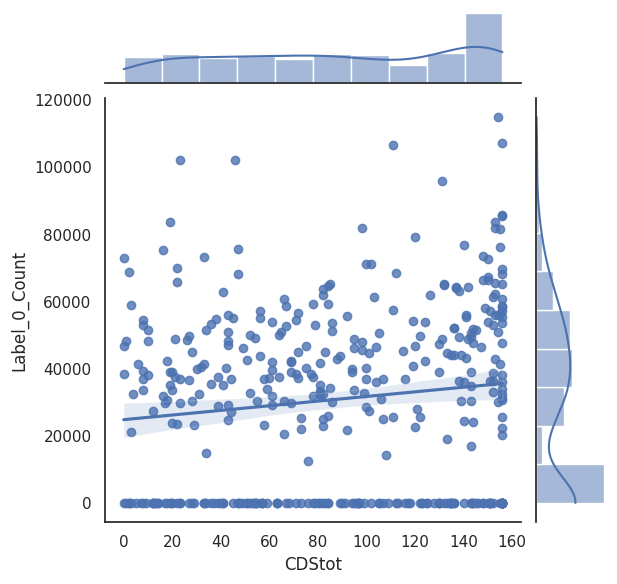

In [176]:
label = 'CDStot'
comparison = 'Label_0_Count'

# Assuming 'merged_df' contains 'agedeath' and 'Label_0_Count'
# cleaned_df = merged_df[merged_df['Label_0_Count'] > 1000].dropna(subset=[label, comparison])
cleaned_df = merged_df.dropna(subset=[label, comparison])

# Simple Linear Regression
X = sm.add_constant(cleaned_df[label])  # adding a constant
model = sm.OLS(cleaned_df[comparison], X).fit()

print(model.summary())

# Plotting the regression line over the scatter plot
plt.figure(figsize=(10, 6))
sns.jointplot(x=label, y=comparison, data=cleaned_df, robust=True, kind="reg") # ci=None removes the confidence interval
# plt.title(f'Linear Regression of {label} on {comparison}')
# plt.xlabel(f'{label}')
# plt.ylabel(comparison)
plt.show()

                            OLS Regression Results                            
Dep. Variable:          Label_0_Count   R-squared:                       0.125
Model:                            OLS   Adj. R-squared:                  0.116
Method:                 Least Squares   F-statistic:                     13.69
Date:                Wed, 24 Apr 2024   Prob (F-statistic):           0.000360
Time:                        19:18:05   Log-Likelihood:                -1125.4
No. Observations:                  98   AIC:                             2255.
Df Residuals:                      96   BIC:                             2260.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        748.5471   5716.369      0.131      0.8

<Figure size 1000x600 with 0 Axes>

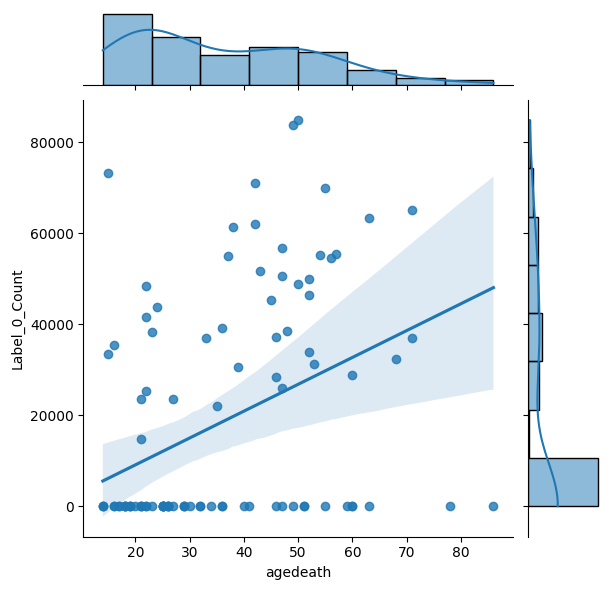

In [189]:
label = 'agedeath'
comparison = 'Label_0_Count'

# Assuming 'merged_df' contains 'agedeath' and 'Label_0_Count'
# cleaned_df = merged_df[merged_df['Label_0_Count'] > 1000].dropna(subset=[label, comparison])
cleaned_df = merged_df[merged_df['cod=suicide']==1].dropna(subset=[label, comparison])

# Simple Linear Regression
X = sm.add_constant(cleaned_df[label])  # adding a constant
model = sm.OLS(cleaned_df[comparison], X).fit()

print(model.summary())

# Plotting the regression line over the scatter plot
plt.figure(figsize=(10, 6))
sns.jointplot(x=label, y=comparison, data=cleaned_df, robust=True, kind="reg") # ci=None removes the confidence interval
# plt.title(f'Linear Regression of {label} on {comparison}')
# plt.xlabel(f'{label}')
# plt.ylabel(comparison)
plt.show()

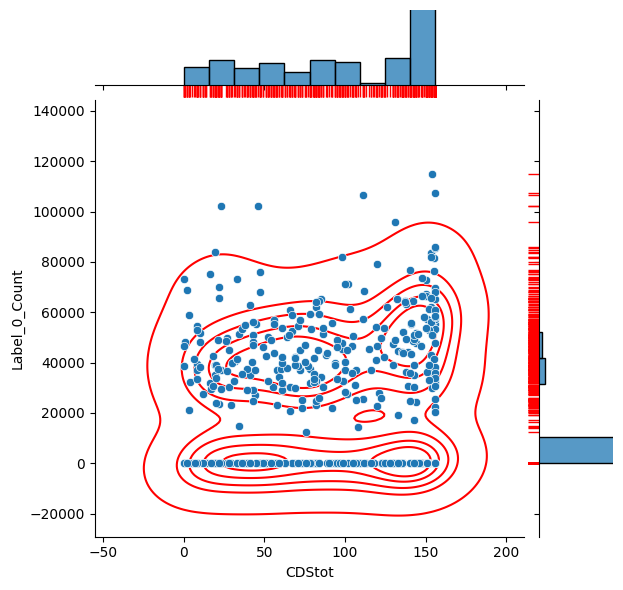

In [151]:
g = sns.jointplot(data=merged_df, x=label, y=comparison)
g.plot_joint(sns.kdeplot, color="r", zorder=0, levels=6)
g.plot_marginals(sns.rugplot, color="r", height=-.15, clip_on=False)

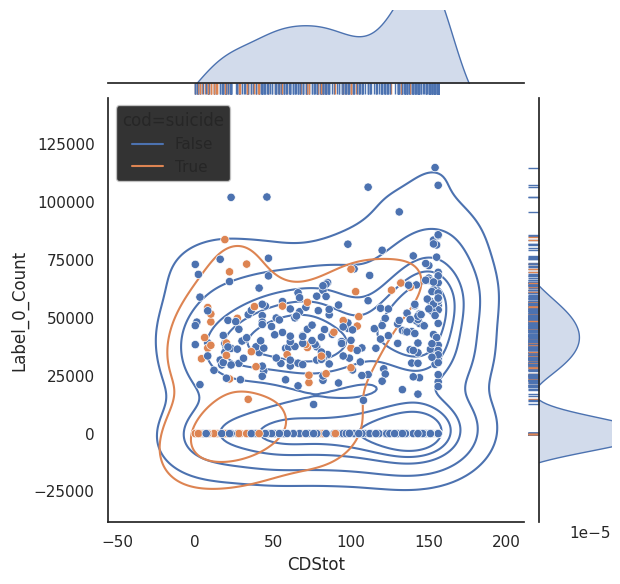

In [174]:
g = sns.jointplot(data=merged_df, x=label, y=comparison, hue='cod=suicide')
g.plot_joint(sns.kdeplot, color="r", zorder=0, levels=6)
g.plot_marginals(sns.rugplot, color="r", height=-.15, clip_on=False)

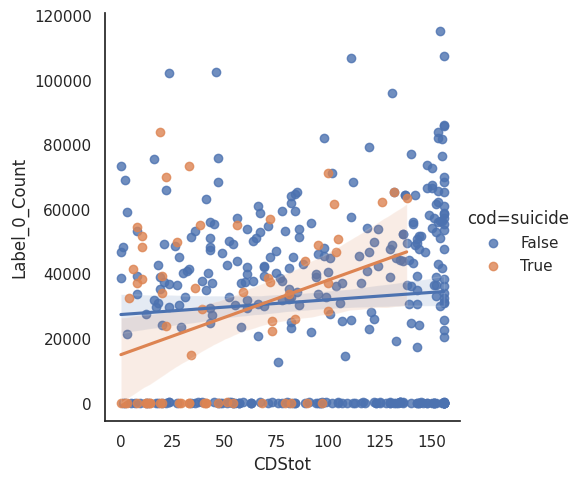

In [179]:
g = sns.lmplot(x=label, y=comparison, data=cleaned_df, robust=True, hue='cod=suicide') # ci=None removes the confidence interval

In [208]:
[_ for _ in merged_df.columns if 'yrs' in _]

['footyrs',
 'hockyrs',
 'socyrs',
 'wresyrs',
 'boxyrs',
 'bryrs',
 'divyrs',
 'karyrs',
 'lacyrs',
 'maryrs',
 'mmayrs',
 'pwresyrs',
 'rugyrs',
 'eqyrs',
 'ssyrs',
 'fhyrs']

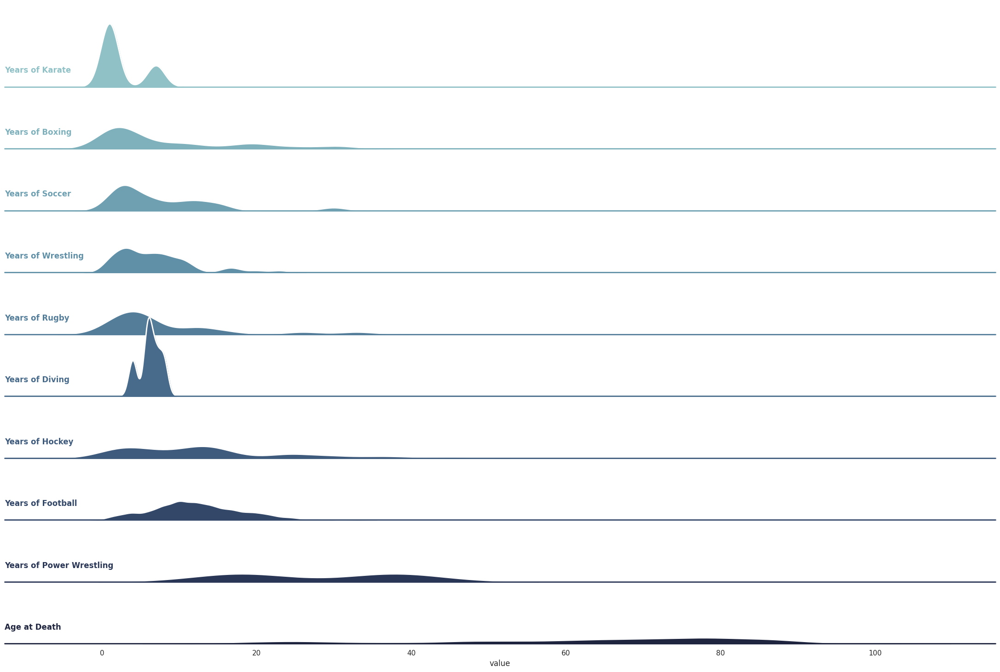

In [227]:
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})

renames = {
#     'ssyrs': 'Years of SS?', 
    'karyrs': 'Years of Karate', 
    'boxyrs': 'Years of Boxing', 
    'socyrs': 'Years of Soccer',
    'wresyrs': 'Years of Wrestling', 
    'rugyrs': 'Years of Rugby', 
    'divyrs': 'Years of Diving', 
    'hockyrs': 'Years of Hockey', 
    'footyrs': 'Years of Football',
    'pwresyrs': 'Years of Power Wrestling', 
    'agedeath': 'Age at Death',
    'aestot': 'AES Score',
    'tbri': 'BRI Score',
    'tmi': 'MI Score', 
    'tgec': 'GEC Score', 
    'CDStot': 'CDS SCore'
}

rename_df = merged_df.copy().rename(columns=renames)

# Filter and melt the data
# melted_data = rename_df[rename_df['Label_0_Count'] > 1000].melt(id_vars=['Slide_ID'],
#                              value_vars=list(renames.values()),
#                              var_name='variable', value_name='value')

melted_data = rename_df.melt(id_vars=['Slide_ID'],
                             value_vars=list(renames.values())[:10],
                             var_name='variable', value_name='value')

# Initialize the FacetGrid object
pal = sns.cubehelix_palette(10, rot=-.25, light=.7)
g = sns.FacetGrid(melted_data, row="variable", hue="variable", aspect=15, height=1.5, palette=pal)

# Draw the densities, now focusing on the 'value' column
g.map(sns.kdeplot, "value",
      bw_adjust=.5, clip_on=False,
      fill=True, alpha=1, linewidth=1.5)
g.map(sns.kdeplot, "value", clip_on=False, color="w", lw=2, bw_adjust=.5)

# Adding a line at y=0 using refline
g.refline(y=0, linewidth=2, linestyle="-", color=None, clip_on=False)

# Function to label the plots in axes coordinates
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, fontweight="bold", color=color,
            ha="left", va="center", transform=ax.transAxes)

# Apply the label function
g.map(label, "value")

# Set the subplots to overlap and adjust plot aesthetics
g.figure.subplots_adjust(hspace=-.25)
g.set_titles("")
g.set(yticks=[], ylabel="")
g.despine(bottom=True, left=True)

# Show the plot
plt.show()

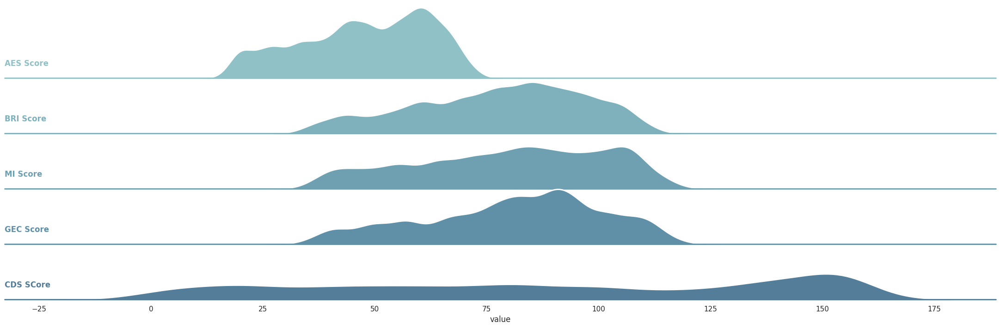

In [216]:
melted_data = rename_df.melt(id_vars=['Slide_ID'],
                             value_vars=list(renames.values())[11:],
                             var_name='variable', value_name='value')

# Initialize the FacetGrid object
pal = sns.cubehelix_palette(10, rot=-.25, light=.7)
g = sns.FacetGrid(melted_data, row="variable", hue="variable", aspect=15, height=1.5, palette=pal)

# Draw the densities, now focusing on the 'value' column
g.map(sns.kdeplot, "value",
      bw_adjust=.5, clip_on=False,
      fill=True, alpha=1, linewidth=1.5)
g.map(sns.kdeplot, "value", clip_on=False, color="w", lw=2, bw_adjust=.5)

# Adding a line at y=0 using refline
g.refline(y=0, linewidth=2, linestyle="-", color=None, clip_on=False)

# Function to label the plots in axes coordinates
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, fontweight="bold", color=color,
            ha="left", va="center", transform=ax.transAxes)

# Apply the label function
g.map(label, "value")

# Set the subplots to overlap and adjust plot aesthetics
g.figure.subplots_adjust(hspace=-.25)
g.set_titles("")
g.set(yticks=[], ylabel="")
g.despine(bottom=True, left=True)

# Show the plot
plt.show()

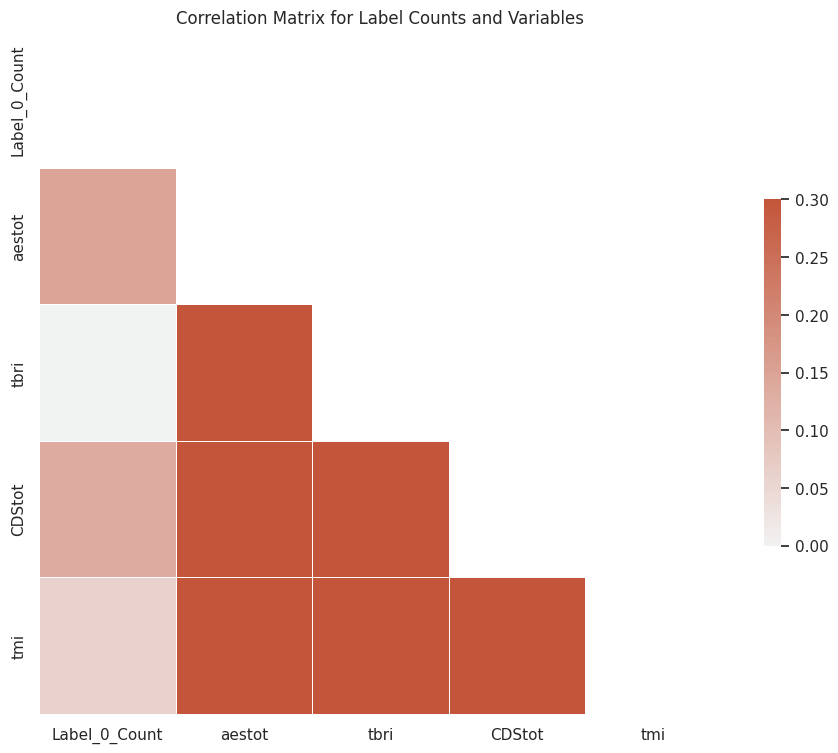

In [167]:
data = merged_df[['Label_0_Count', 'aestot', 'tbri', 'CDStot', 'tmi']]
corr = data.corr()
mask = np.triu(np.ones_like(corr, dtype=bool))

f, ax = plt.subplots(figsize=(11, 9))

cmap = sns.diverging_palette(230, 20, as_cmap=True)

sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

plt.title('Correlation Matrix for Label Counts and Variables')
plt.show()

In [138]:
import scipy as sp

def annotate(data, **kws):
    r, p = sp.stats.pearsonr(data['total_bill'], data['tip'])
    ax = plt.gca()
    ax.text(.05, .8, 'r={:.2f}, p={:.2g}'.format(r, p),
            transform=ax.transAxes)

AttributeError: 'PairGrid' object has no attribute 'map_dataframe'

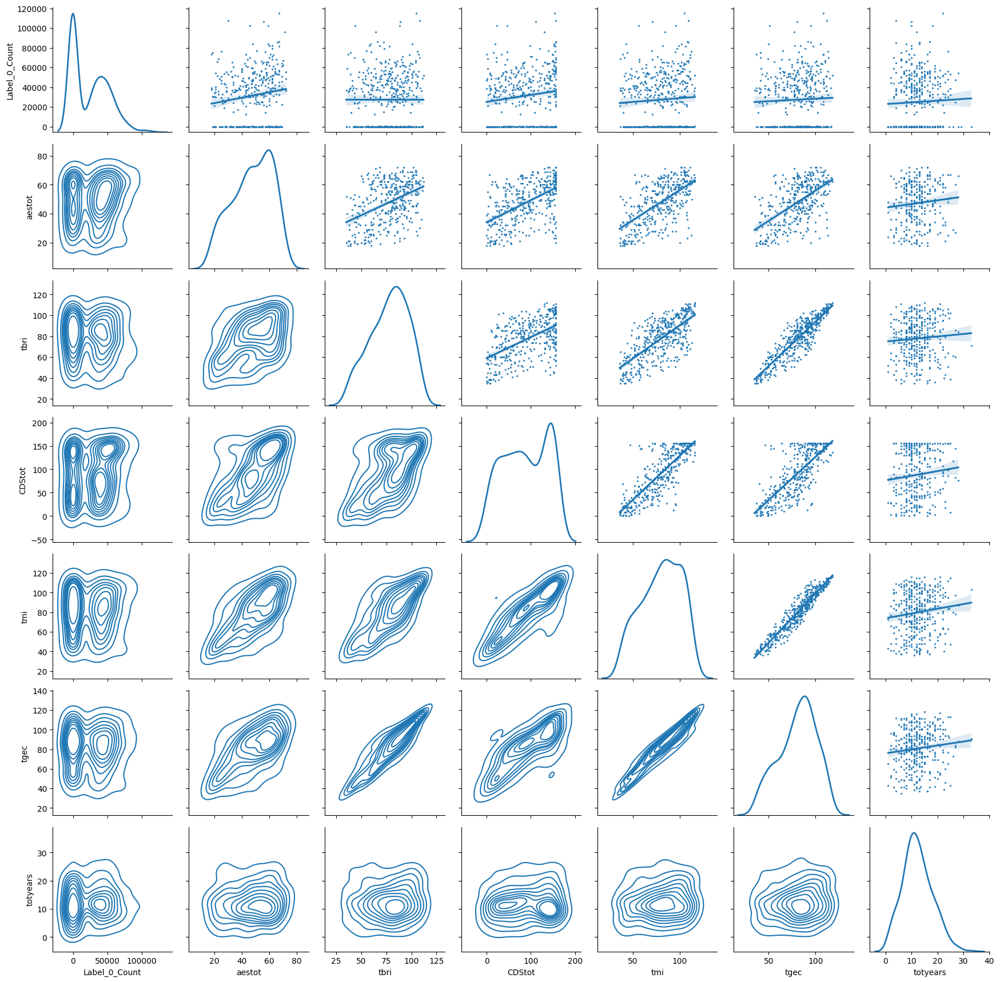

In [177]:
# sns.set_theme(style="white")

# df = sns.load_dataset("penguins")

g = sns.PairGrid(data, diag_sharey=False)
g.map_upper(sns.regplot, scatter_kws={'s':2})
g.map_lower(sns.kdeplot)
g.map_diag(sns.kdeplot, lw=2)
# g.map_dataframe(annotate)

In [179]:
[_ for _ in merged_df.columns if 'yrs' in _]

['footyrs',
 'hockyrs',
 'socyrs',
 'wresyrs',
 'boxyrs',
 'bryrs',
 'divyrs',
 'karyrs',
 'lacyrs',
 'maryrs',
 'mmayrs',
 'pwresyrs',
 'rugyrs',
 'eqyrs',
 'ssyrs',
 'fhyrs']

/sc/arion/work/koenid03/conda/envs/GPUClone2/lib/python3.10/site-packages/seaborn/axisgrid.py:1615: UserWarning: KDE cannot be estimated (0 variance or perfect covariance). Pass `warn_singular=False` to disable this warning.
  func(x=x, y=y, **kwargs)


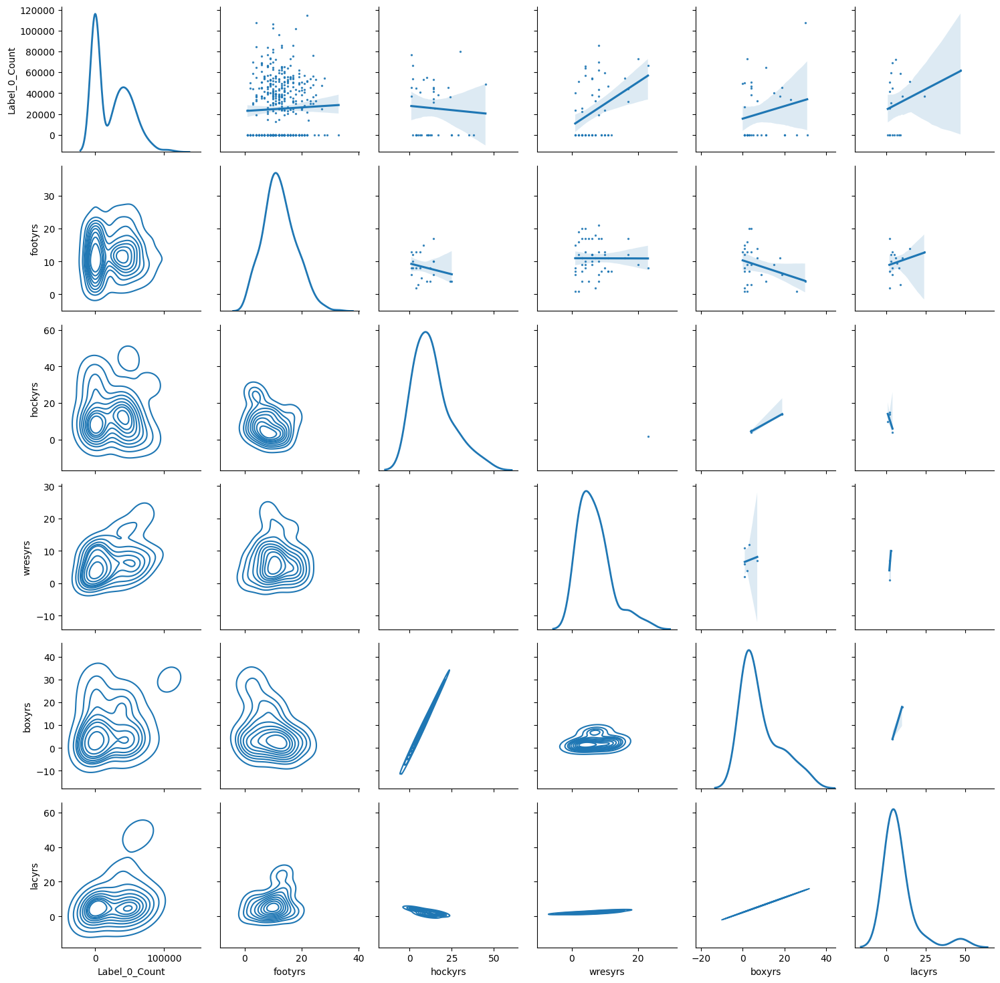

In [185]:
g = sns.PairGrid(merged_df[['Label_0_Count', 'footyrs',
 'hockyrs',
 'wresyrs',
 'boxyrs',
 'lacyrs']], diag_sharey=False)
g.map_upper(sns.regplot, scatter_kws={'s':2})
g.map_lower(sns.kdeplot)
g.map_diag(sns.kdeplot, lw=2)

In [173]:
merged_df['totyears'] = np.vectorize(np.sum)(merged_df[['footyrs', 'hockyrs', 'socyrs', 'wresyrs', 'boxyrs', 'bryrs', 'divyrs',
                                  'karyrs', 'lacyrs', 'maryrs', 'mmayrs', 'pwresyrs', 'rugyrs', 'eqyrs',
                                  'ssyrs', 'fhyrs']])

                            OLS Regression Results                            
Dep. Variable:          Label_0_Count   R-squared:                       0.018
Model:                            OLS   Adj. R-squared:                  0.015
Method:                 Least Squares   F-statistic:                     7.242
Date:                Wed, 24 Apr 2024   Prob (F-statistic):            0.00742
Time:                        18:47:53   Log-Likelihood:                -4647.7
No. Observations:                 401   AIC:                             9299.
Df Residuals:                     399   BIC:                             9307.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       2.507e+04   2646.113      9.475      0.0

<Figure size 1000x600 with 0 Axes>

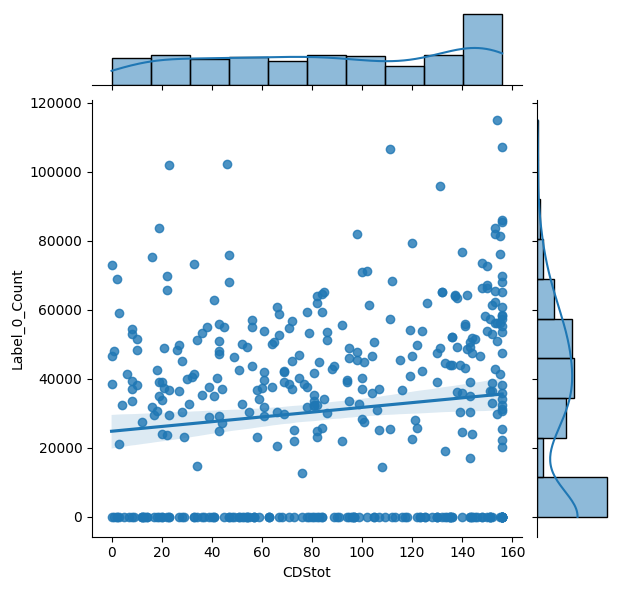

                            OLS Regression Results                            
Dep. Variable:          Label_0_Count   R-squared:                       0.022
Model:                            OLS   Adj. R-squared:                  0.020
Method:                 Least Squares   F-statistic:                     8.617
Date:                Wed, 24 Apr 2024   Prob (F-statistic):            0.00353
Time:                        18:51:07   Log-Likelihood:                -4404.6
No. Observations:                 380   AIC:                             8813.
Df Residuals:                     378   BIC:                             8821.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       1.828e+04   4672.132      3.913      0.0

<Figure size 1000x600 with 0 Axes>

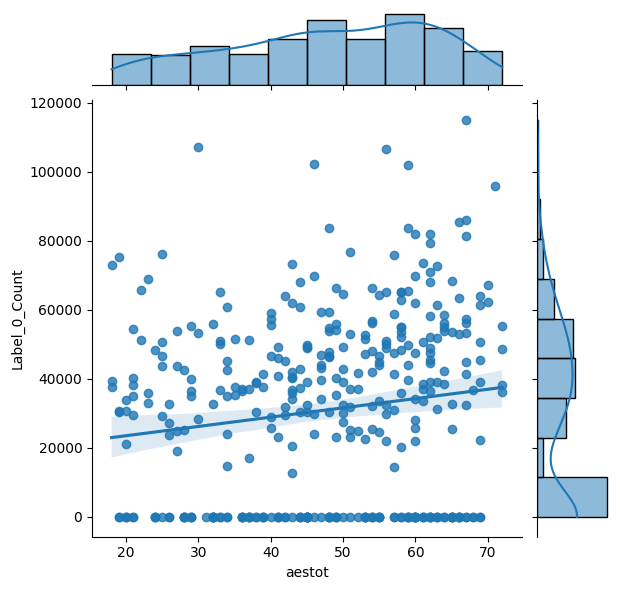

In [186]:
for label in ['CDStot', 'aestot']: 
    comparison = 'Label_0_Count'

    # Assuming 'merged_df' contains 'agedeath' and 'Label_0_Count'
    # cleaned_df = merged_df[merged_df['Label_0_Count'] > 1000].dropna(subset=[label, comparison])
    cleaned_df = merged_df.dropna(subset=[label, comparison])

    # Simple Linear Regression
    X = sm.add_constant(cleaned_df[label])  # adding a constant
    model = sm.OLS(cleaned_df[comparison], X).fit()

    print(model.summary())

    # Plotting the regression line over the scatter plot
    plt.figure(figsize=(10, 6))
    sns.jointplot(x=label, y=comparison, data=cleaned_df, robust=True, kind="reg") # ci=None removes the confidence interval
    plt.show()

                            OLS Regression Results                            
Dep. Variable:          Label_0_Count   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                    0.6610
Date:                Wed, 24 Apr 2024   Prob (F-statistic):              0.417
Time:                        18:54:21   Log-Likelihood:                -5474.7
No. Observations:                 472   AIC:                         1.095e+04
Df Residuals:                     470   BIC:                         1.096e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       2.283e+04   2905.756      7.857      0.0

<Figure size 1000x600 with 0 Axes>

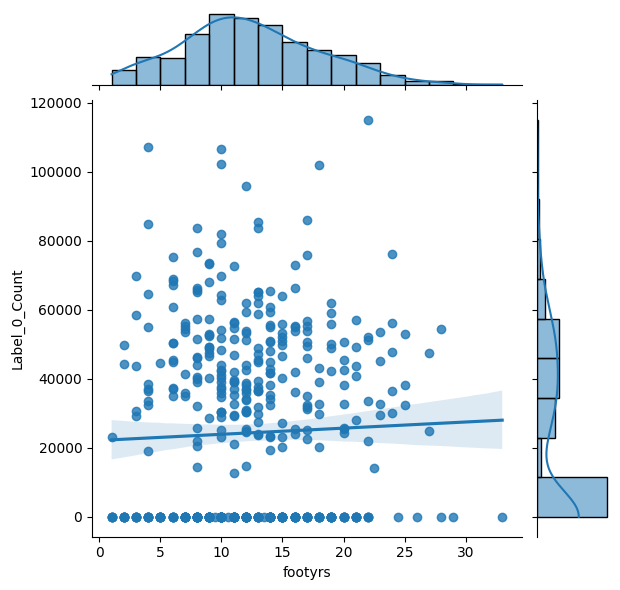

                            OLS Regression Results                            
Dep. Variable:          Label_0_Count   R-squared:                       0.005
Model:                            OLS   Adj. R-squared:                 -0.021
Method:                 Least Squares   F-statistic:                    0.1813
Date:                Wed, 24 Apr 2024   Prob (F-statistic):              0.673
Time:                        18:57:38   Log-Likelihood:                -462.23
No. Observations:                  40   AIC:                             928.5
Df Residuals:                      38   BIC:                             931.8
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       2.779e+04   6615.130      4.201      0.0

<Figure size 1000x600 with 0 Axes>

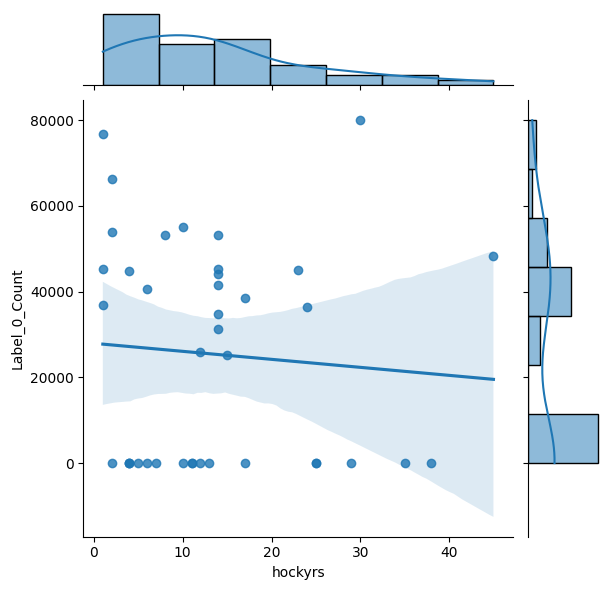

                            OLS Regression Results                            
Dep. Variable:          Label_0_Count   R-squared:                       0.144
Model:                            OLS   Adj. R-squared:                  0.128
Method:                 Least Squares   F-statistic:                     8.770
Date:                Wed, 24 Apr 2024   Prob (F-statistic):            0.00461
Time:                        18:57:39   Log-Likelihood:                -623.12
No. Observations:                  54   AIC:                             1250.
Df Residuals:                      52   BIC:                             1254.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       8803.7450   5925.669      1.486      0.1

<Figure size 1000x600 with 0 Axes>

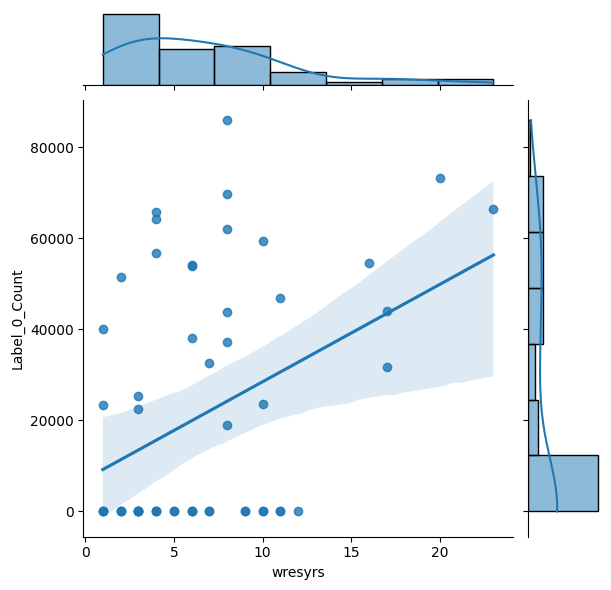

                            OLS Regression Results                            
Dep. Variable:          Label_0_Count   R-squared:                       0.038
Model:                            OLS   Adj. R-squared:                  0.010
Method:                 Least Squares   F-statistic:                     1.358
Date:                Wed, 24 Apr 2024   Prob (F-statistic):              0.252
Time:                        18:57:41   Log-Likelihood:                -418.16
No. Observations:                  36   AIC:                             840.3
Df Residuals:                      34   BIC:                             843.5
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       1.549e+04   6350.938      2.439      0.0

<Figure size 1000x600 with 0 Axes>

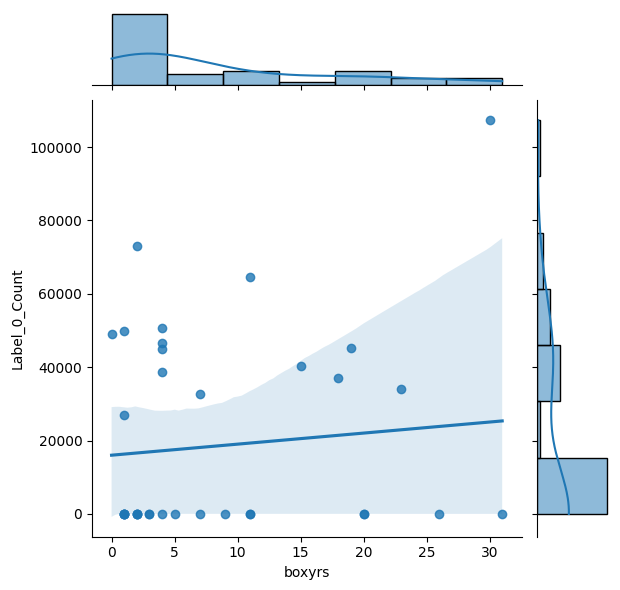

                            OLS Regression Results                            
Dep. Variable:          Label_0_Count   R-squared:                       0.094
Model:                            OLS   Adj. R-squared:                  0.046
Method:                 Least Squares   F-statistic:                     1.960
Date:                Wed, 24 Apr 2024   Prob (F-statistic):              0.178
Time:                        18:57:44   Log-Likelihood:                -242.52
No. Observations:                  21   AIC:                             489.0
Df Residuals:                      19   BIC:                             491.1
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       2.407e+04   7336.121      3.281      0.0

<Figure size 1000x600 with 0 Axes>

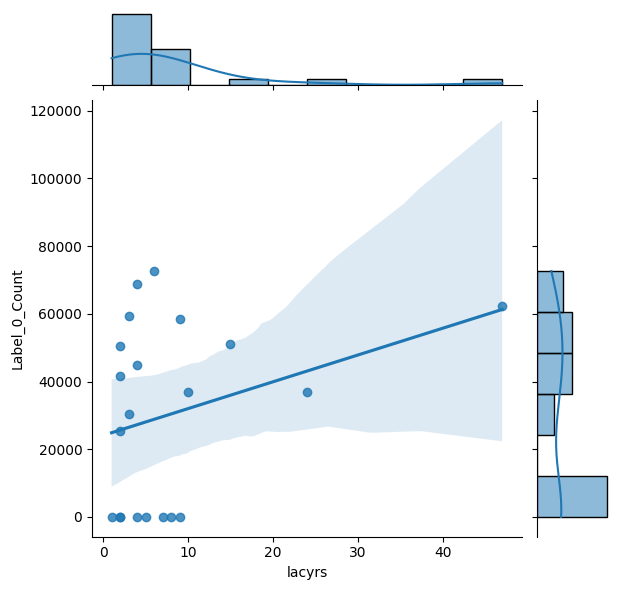

In [187]:
for label in ['footyrs',
              'hockyrs',
              'wresyrs',
              'boxyrs',
              'lacyrs']: 
    comparison = 'Label_0_Count'

    # Assuming 'merged_df' contains 'agedeath' and 'Label_0_Count'
    # cleaned_df = merged_df[merged_df['Label_0_Count'] > 1000].dropna(subset=[label, comparison])
    cleaned_df = merged_df.dropna(subset=[label, comparison])

    # Simple Linear Regression
    X = sm.add_constant(cleaned_df[label])  # adding a constant
    model = sm.OLS(cleaned_df[comparison], X).fit()

    print(model.summary())

    # Plotting the regression line over the scatter plot
    plt.figure(figsize=(10, 6))
    sns.jointplot(x=label, y=comparison, data=cleaned_df, robust=True, kind="reg") # ci=None removes the confidence interval
    # plt.title(f'Linear Regression of {label} on {comparison}')
    # plt.xlabel(f'{label}')
    # plt.ylabel(comparison)
    plt.show()

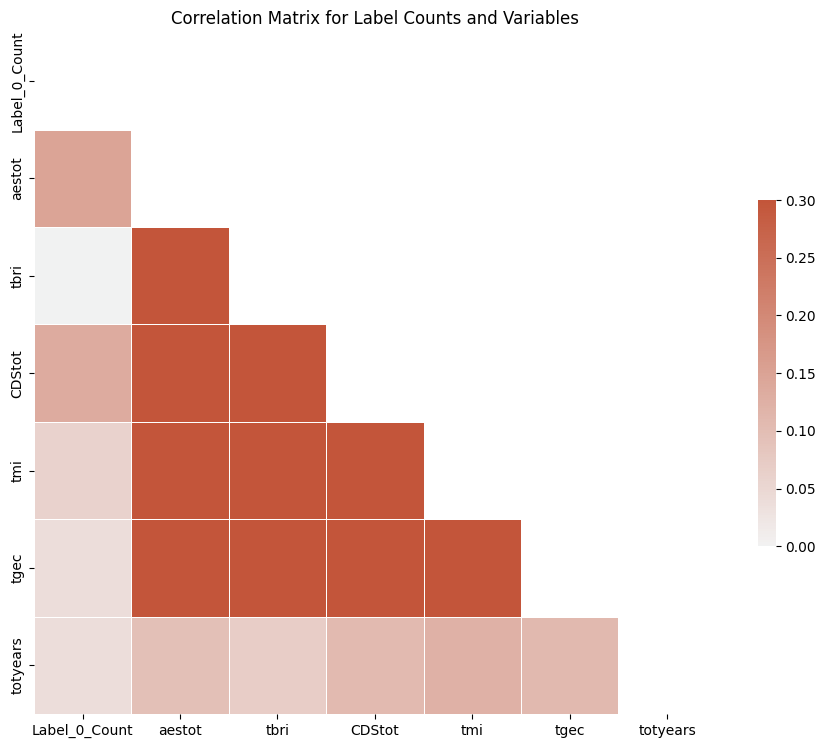

In [176]:
data = merged_df[['Label_0_Count', 'aestot', 'tbri', 'CDStot', 'tmi', 'tgec', 'totyears']]
corr = data.corr()
mask = np.triu(np.ones_like(corr, dtype=bool))

f, ax = plt.subplots(figsize=(11, 9))

cmap = sns.diverging_palette(230, 20, as_cmap=True)

sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

plt.title('Correlation Matrix for Label Counts and Variables')
plt.show()

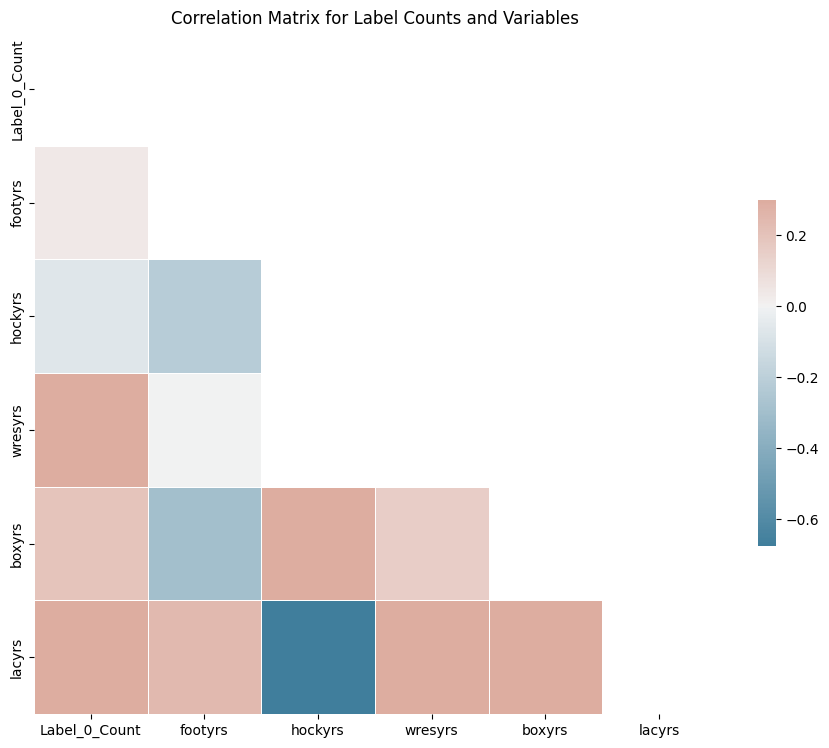

In [188]:
data = merged_df[['Label_0_Count', 'footyrs',
              'hockyrs',
              'wresyrs',
              'boxyrs',
              'lacyrs']]
corr = data.corr()
mask = np.triu(np.ones_like(corr, dtype=bool))

f, ax = plt.subplots(figsize=(11, 9))

cmap = sns.diverging_palette(230, 20, as_cmap=True)

sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

plt.title('Correlation Matrix for Label Counts and Variables')
plt.show()